In [1]:
from __future__ import print_function, division

from keras.layers import Input, Dense, Flatten, Dropout, Reshape, Concatenate
from keras.layers import BatchNormalization, Activation, Conv2D, Conv2DTranspose
from keras.layers.advanced_activations import LeakyReLU
from keras.models import Model
from keras.optimizers import Adam

from keras.datasets import cifar10
import keras.backend as K

import matplotlib.pyplot as plt

import sys
import numpy as np

%pylab inline

Using TensorFlow backend.


Populating the interactive namespace from numpy and matplotlib


In [0]:
def get_generator(input_layer, condition_layer):

    merged_input = Concatenate()([input_layer, condition_layer])

    hid = Dense(128 * 8 * 8, activation='relu')(merged_input)    
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)
    hid = Reshape((8, 8, 128))(hid)

    hid = Conv2D(128, kernel_size=4, strides=1,padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)    
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2DTranspose(128, 4, strides=2, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(128, kernel_size=5, strides=1,padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)    
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2DTranspose(128, 4, strides=2, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(128, kernel_size=5, strides=1, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(128, kernel_size=5, strides=1, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(3, kernel_size=5, strides=1, padding="same")(hid)
    
    
    out = Activation("tanh")(hid)

    model = Model(inputs=[input_layer, condition_layer], outputs=out)
    model.summary()

    return model, out

In [0]:
def get_discriminator(input_layer, condition_layer):
    hid = Conv2D(128, kernel_size=3, strides=1, padding='same')(input_layer)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(128, kernel_size=4, strides=2, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(128, kernel_size=4, strides=2, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Conv2D(128, kernel_size=4, strides=2, padding='same')(hid)
    hid = BatchNormalization(momentum=0.9)(hid)
    hid = LeakyReLU(alpha=0.1)(hid)

    hid = Flatten()(hid)

    merged_layer = Concatenate()([hid, condition_layer])
    hid = Dense(512, activation='relu')(merged_layer)
    #hid = Dropout(0.4)(hid)
    out = Dense(1, activation='sigmoid')(hid)

    model = Model(inputs=[input_layer, condition_layer], outputs=out)

    model.summary()

    return model, out

In [0]:
from keras.preprocessing import image

def one_hot_encode(y):
    z = np.zeros((len(y), 10))
    idx = np.arange(len(y))
    z[idx, y] = 1
    return z

def generate_noise(n_samples, noise_dim):
    X = np.random.normal(0, 1, size=(n_samples, noise_dim))
    return X

def generate_random_labels(n):
    y = np.random.choice(10, n)
    y = one_hot_encode(y)
    return y

tags = ['Airplane', 'Automobile', 'Bird', 'Cat', 'Deer', 'Dog', 'Frog', 'Horse', 'Ship', 'Truck']


def show_samples(batchidx):
    fig, axs = plt.subplots(5, 6, figsize=(10,6))
    plt.subplots_adjust(hspace=0.3, wspace=0.1)
    #fig, axs = plt.subplots(5, 6)
    #fig.tight_layout()
    for classlabel in range(10):
        row = int(classlabel / 2)
        coloffset = (classlabel % 2) * 3
        lbls = one_hot_encode([classlabel] * 3)
        noise = generate_noise(3, 100)
        gen_imgs = generator.predict([noise, lbls])

        for i in range(3):
            # Dont scale the images back, let keras handle it
            img = image.array_to_img(gen_imgs[i], scale=True)
            axs[row,i+coloffset].imshow(img)
            axs[row,i+coloffset].axis('off')
            if i ==1:
                axs[row,i+coloffset].set_title(tags[classlabel])
    plt.show()
    plt.close()

In [5]:
# GAN creation
img_input = Input(shape=(32,32,3))
disc_condition_input = Input(shape=(10,))

discriminator, disc_out = get_discriminator(img_input, disc_condition_input)
discriminator.compile(optimizer=Adam(0.0002, 0.5), loss='binary_crossentropy', metrics=['accuracy'])

discriminator.trainable = False

noise_input = Input(shape=(100,))
gen_condition_input = Input(shape=(10,))
generator, gen_out = get_generator(noise_input, gen_condition_input)

gan_input = Input(shape=(100,))
x = generator([gan_input, gen_condition_input])
gan_out = discriminator([x, disc_condition_input])
gan = Model(inputs=[gan_input, gen_condition_input, disc_condition_input], output=gan_out)
gan.summary()

gan.compile(optimizer=Adam(0.0002, 0.5), loss='binary_crossentropy')

W0824 11:02:33.059136 139948663437184 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0824 11:02:33.072463 139948663437184 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0824 11:02:33.077207 139948663437184 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0824 11:02:33.099410 139948663437184 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0824 11:02:33.100157 1399486634

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 32, 32, 128)  3584        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 32, 32, 128)  512         conv2d_1[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, 32, 32, 128)  0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
conv2d_2 (

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=[<tf.Tenso..., outputs=Tensor("mo...)`
  app.launch_new_instance()


In [6]:
BATCH_SIZE = 16

# # Get training images
(X_train, y_train), (X_test, _) = cifar10.load_data()

# Normalize data
X_train = (X_train - 127.5) / 127.5

# 1hot encode labels
y_train = one_hot_encode(y_train[:,0])

print ("Training shape: {}".format(X_train.shape))
 
num_batches = int(X_train.shape[0]/BATCH_SIZE)

Training shape: (50000, 32, 32, 3)


In [0]:
# Array to store samples for experience replay
exp_replay = []

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


	Epoch: 1, Generator Loss: 0.005959166300296783, Discriminator Loss: [0.00282915 0.        ]


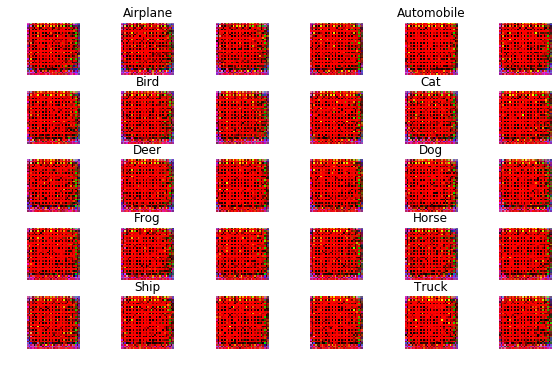

	Epoch: 2, Generator Loss: 0.004788281989097596, Discriminator Loss: [0.00126096 0.        ]


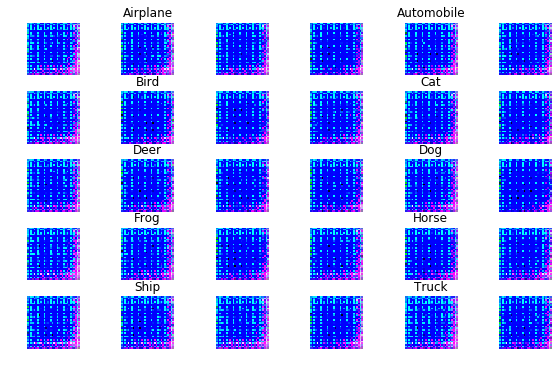

	Epoch: 3, Generator Loss: 0.0034737112361192704, Discriminator Loss: [0.00164522 0.        ]


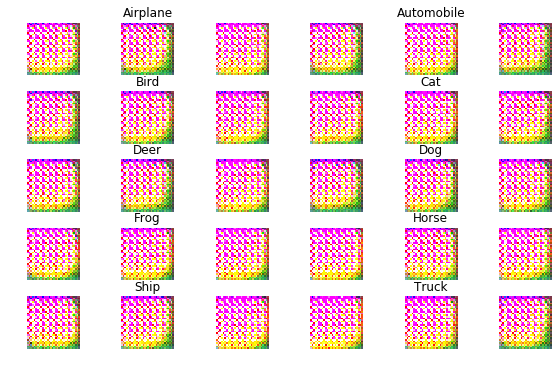

	Epoch: 4, Generator Loss: 0.0026689503955841065, Discriminator Loss: [0.00126722 0.        ]


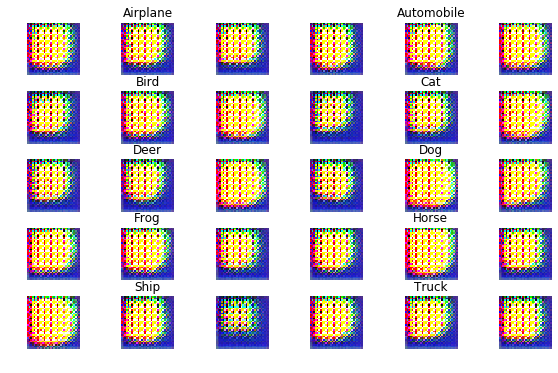

	Epoch: 5, Generator Loss: 0.006151554983854294, Discriminator Loss: [0.00129487 0.        ]


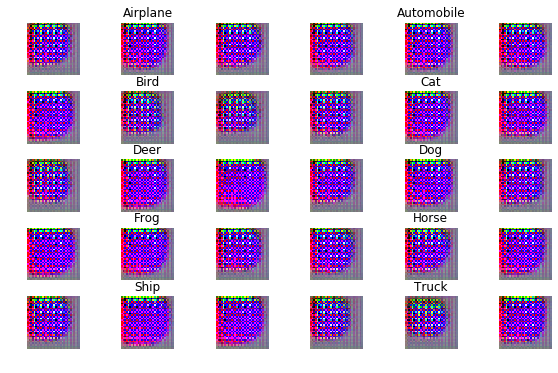

	Epoch: 6, Generator Loss: 0.005588457708358765, Discriminator Loss: [0.00127011 0.        ]


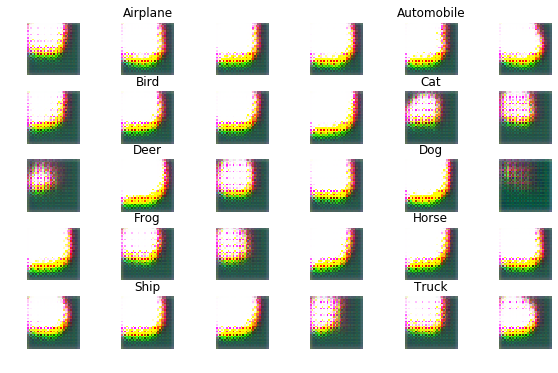

	Epoch: 7, Generator Loss: 0.016125581035614015, Discriminator Loss: [0.0017384 0.       ]


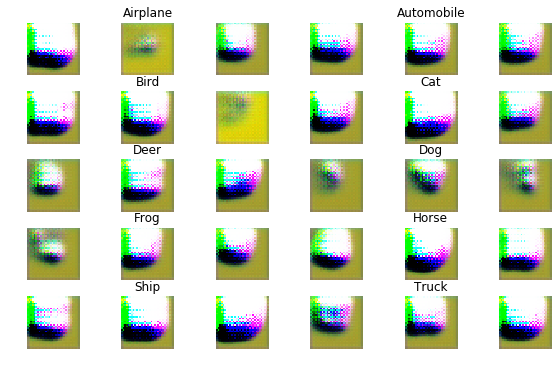

	Epoch: 8, Generator Loss: 0.009181459522247314, Discriminator Loss: [0.00129192 0.        ]


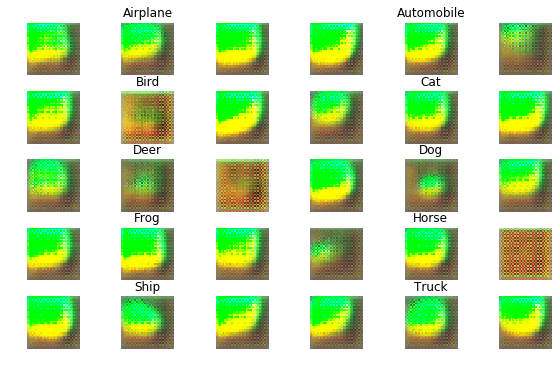

	Epoch: 9, Generator Loss: 0.011961355476379394, Discriminator Loss: [0.00125194 0.        ]


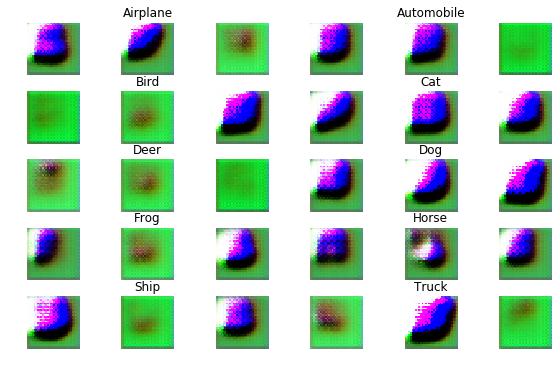

	Epoch: 10, Generator Loss: 0.012229310607910156, Discriminator Loss: [0.00132177 0.        ]


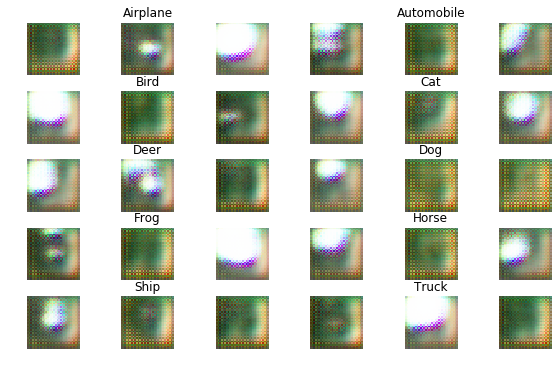

	Epoch: 11, Generator Loss: 0.011152966613769532, Discriminator Loss: [0.00167032 0.        ]


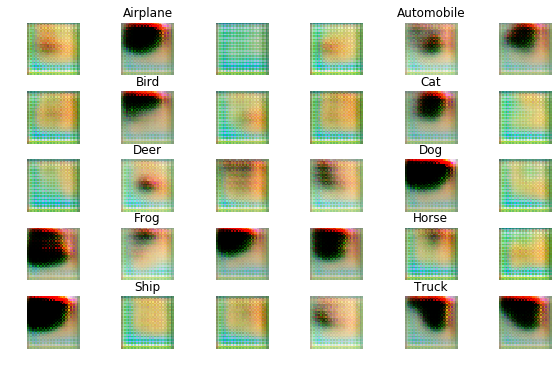

	Epoch: 12, Generator Loss: 0.007879108190536499, Discriminator Loss: [0.00159126 0.        ]


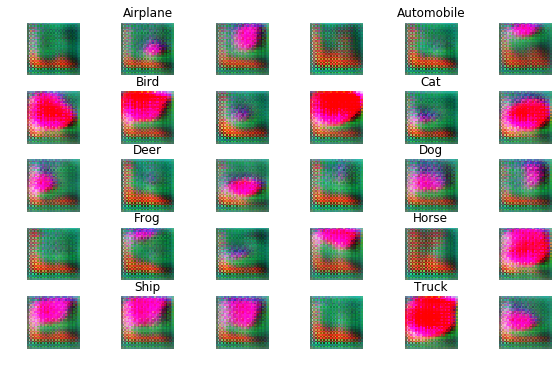

	Epoch: 13, Generator Loss: 0.005199474873542786, Discriminator Loss: [0.00116491 0.        ]


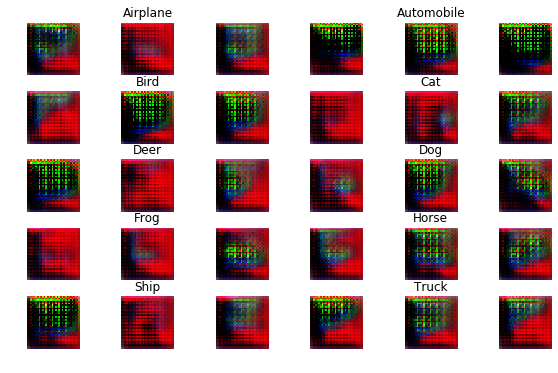

	Epoch: 14, Generator Loss: 0.00986570426940918, Discriminator Loss: [0.0011814 0.       ]


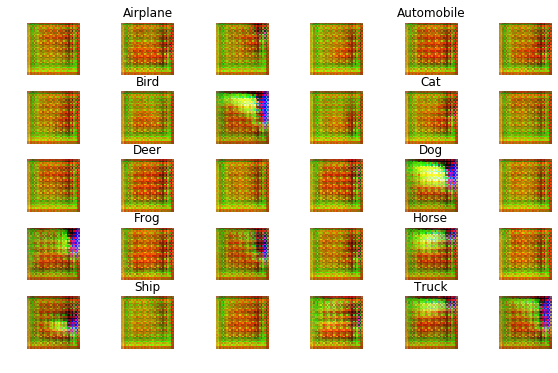

	Epoch: 15, Generator Loss: 0.002745888221859932, Discriminator Loss: [0.00118963 0.        ]


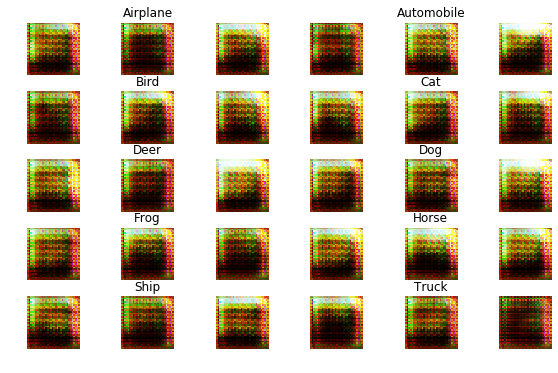

	Epoch: 16, Generator Loss: 0.0025370550000667572, Discriminator Loss: [0.00121582 0.        ]


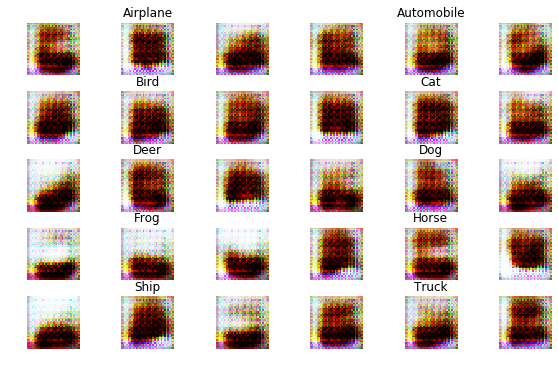

	Epoch: 17, Generator Loss: 0.016086276779174805, Discriminator Loss: [0.00170255 0.        ]


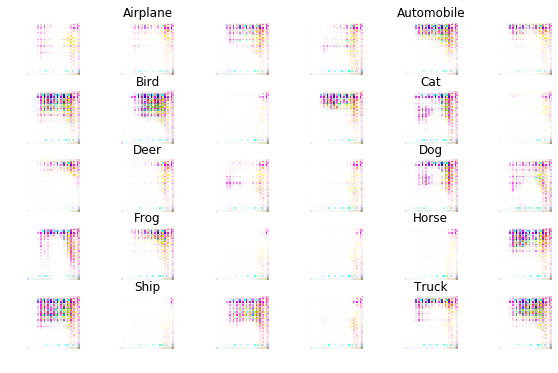

	Epoch: 18, Generator Loss: 0.01003818820953369, Discriminator Loss: [0.00103723 0.        ]


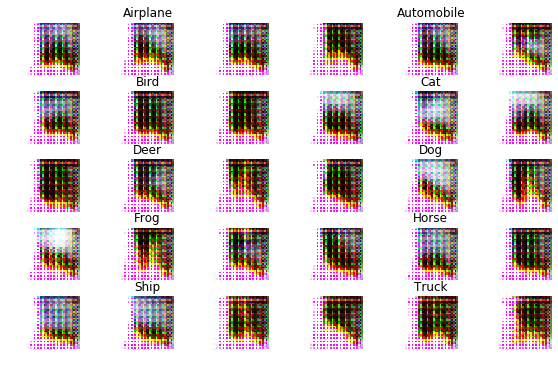

	Epoch: 19, Generator Loss: 0.010492338409423829, Discriminator Loss: [0.00127213 0.        ]


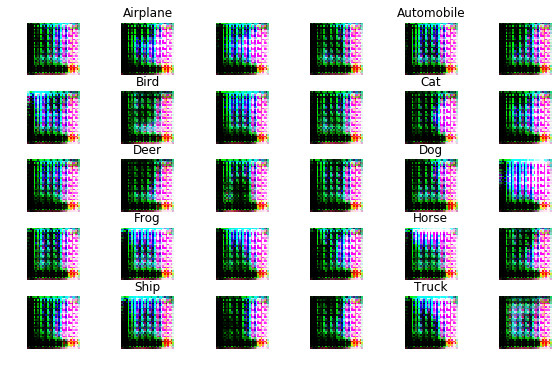

	Epoch: 20, Generator Loss: 0.00910925585746765, Discriminator Loss: [0.00119589 0.        ]


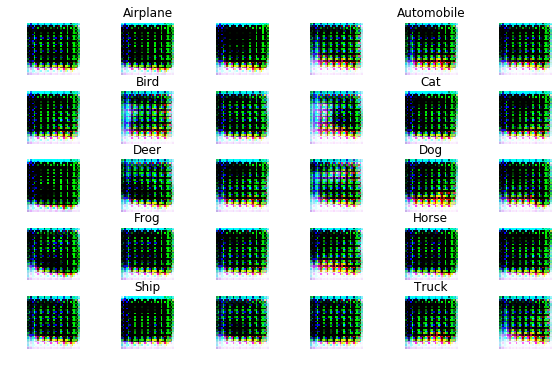

	Epoch: 21, Generator Loss: 0.006377195644378662, Discriminator Loss: [0.00112777 0.        ]


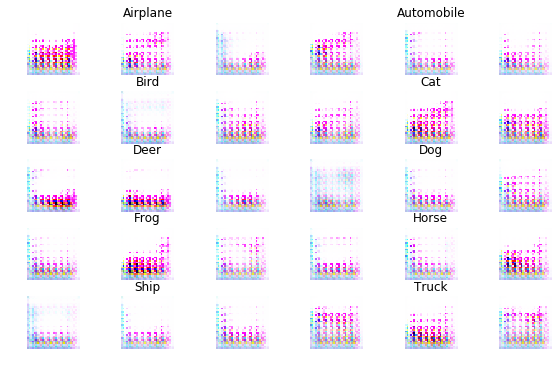

	Epoch: 22, Generator Loss: 0.0019662458503246307, Discriminator Loss: [0.0010725 0.       ]


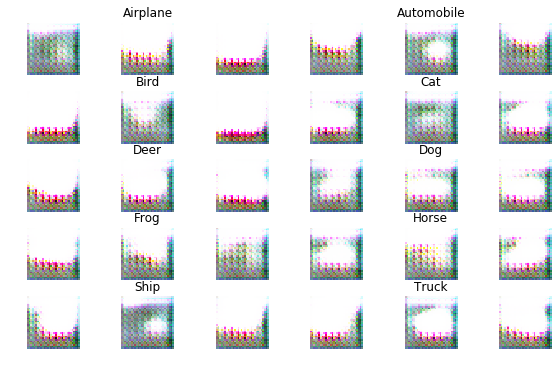

	Epoch: 23, Generator Loss: 0.003671048843860626, Discriminator Loss: [0.00138061 0.        ]


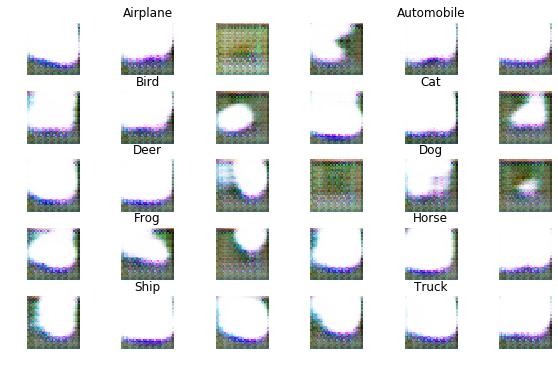

	Epoch: 24, Generator Loss: 0.004817669944763184, Discriminator Loss: [0.00131191 0.        ]


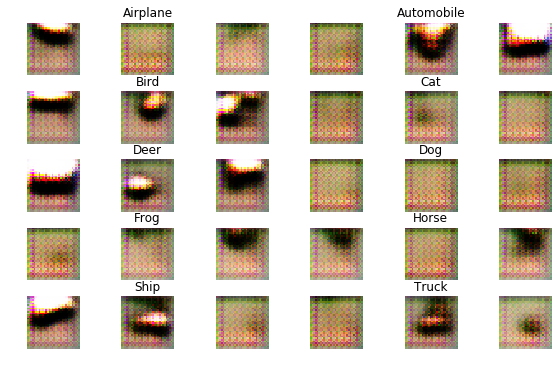

	Epoch: 25, Generator Loss: 0.003264849691390991, Discriminator Loss: [0.00149946 0.        ]


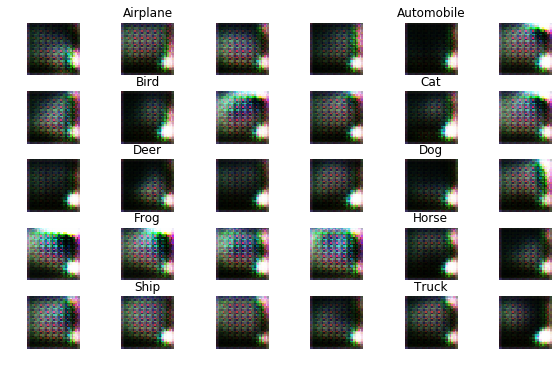

	Epoch: 26, Generator Loss: 0.011633518762588502, Discriminator Loss: [0.00137987 0.        ]


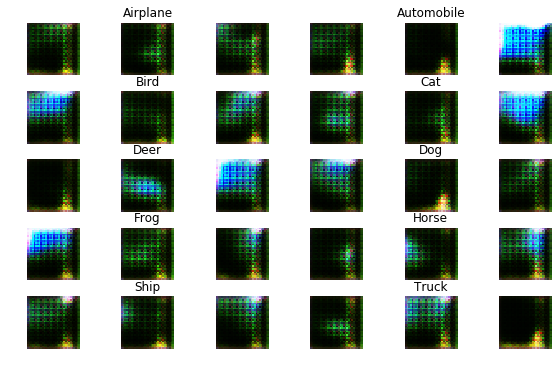

	Epoch: 27, Generator Loss: 0.001406057139635086, Discriminator Loss: [0.0010944 0.       ]


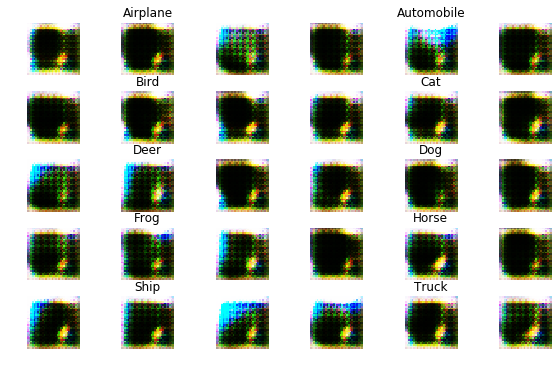

	Epoch: 28, Generator Loss: 0.0071933586311340334, Discriminator Loss: [0.00149513 0.        ]


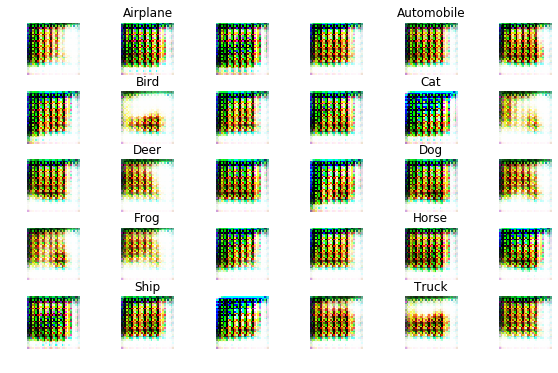

	Epoch: 29, Generator Loss: 0.009430212497711182, Discriminator Loss: [0.00116695 0.        ]


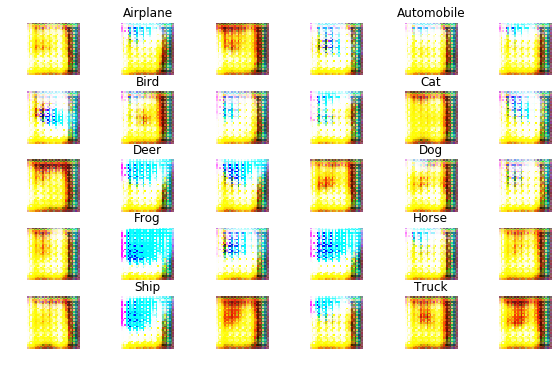

	Epoch: 30, Generator Loss: 0.006423912115097046, Discriminator Loss: [0.00124313 0.        ]


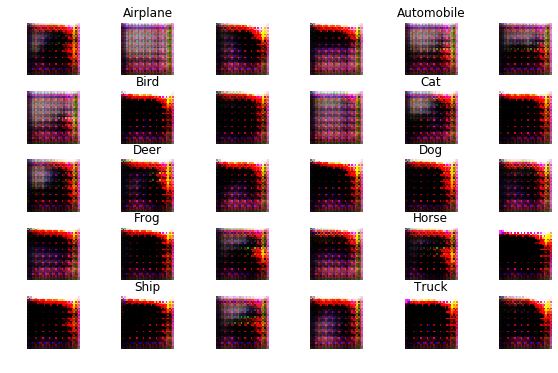

	Epoch: 31, Generator Loss: 0.004836734702587128, Discriminator Loss: [0.00130006 0.        ]


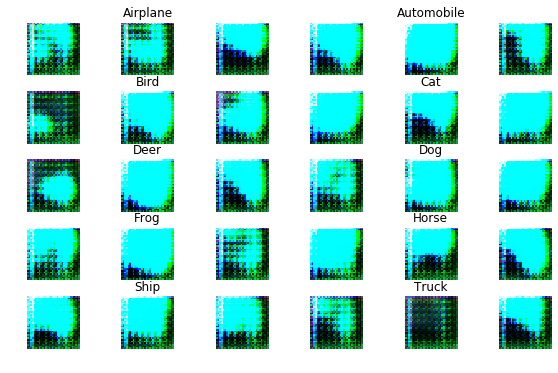

	Epoch: 32, Generator Loss: 0.0027951468086242675, Discriminator Loss: [0.00125093 0.        ]


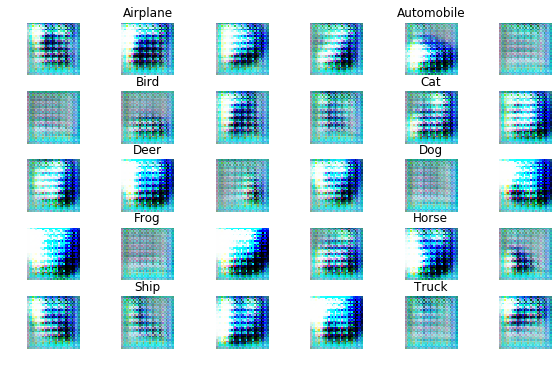

	Epoch: 33, Generator Loss: 0.011496139755249024, Discriminator Loss: [0.00146422 0.        ]


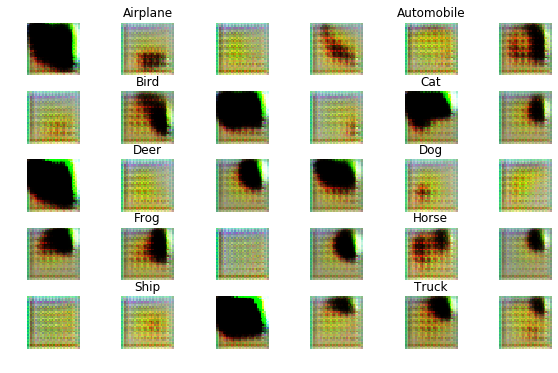

	Epoch: 34, Generator Loss: 0.00922174831390381, Discriminator Loss: [0.00168369 0.        ]


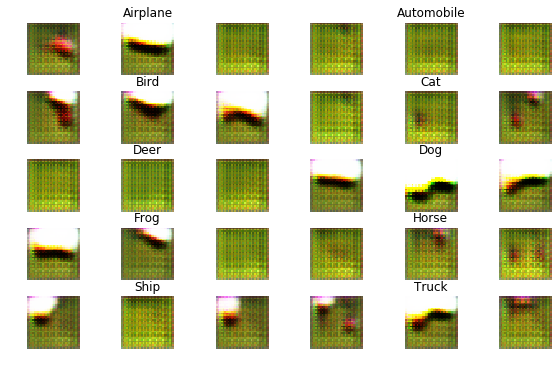

	Epoch: 35, Generator Loss: 0.009851282386779785, Discriminator Loss: [0.00123148 0.        ]


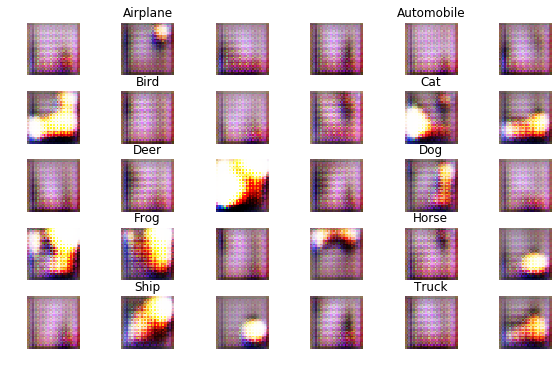

	Epoch: 36, Generator Loss: 0.01271442512512207, Discriminator Loss: [0.00131443 0.        ]


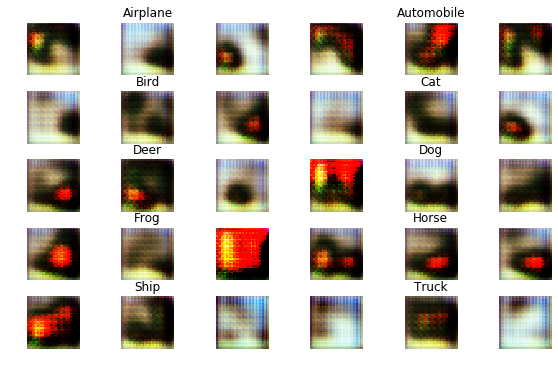

	Epoch: 37, Generator Loss: 0.011938052711486817, Discriminator Loss: [0.00146836 0.        ]


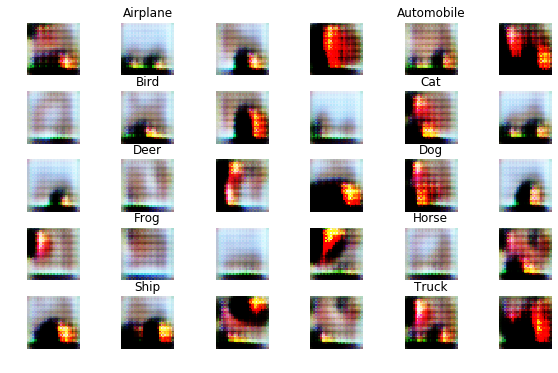

	Epoch: 38, Generator Loss: 0.009753141098022462, Discriminator Loss: [0.00140383 0.        ]


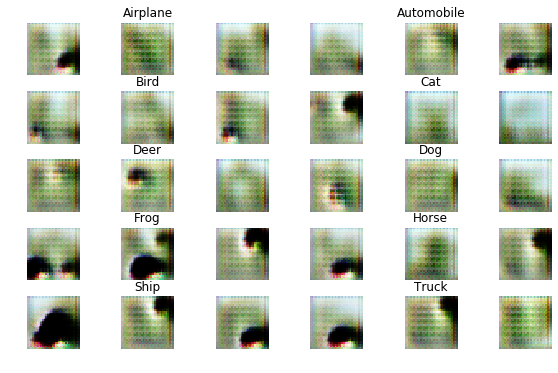

	Epoch: 39, Generator Loss: 0.008933855171203613, Discriminator Loss: [0.00159917 0.        ]


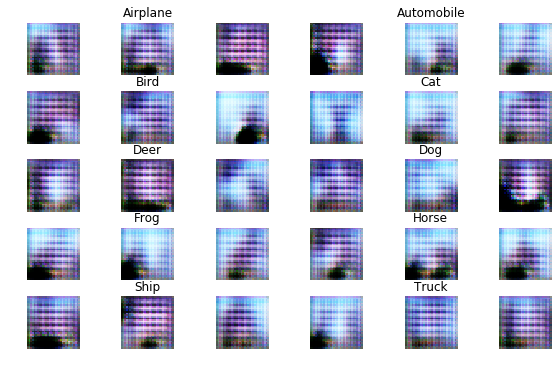

	Epoch: 40, Generator Loss: 0.012357306690216065, Discriminator Loss: [0.00141625 0.        ]


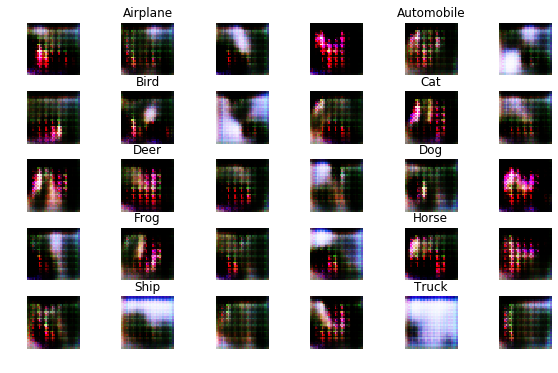

	Epoch: 41, Generator Loss: 0.009004704570770263, Discriminator Loss: [0.00117455 0.        ]


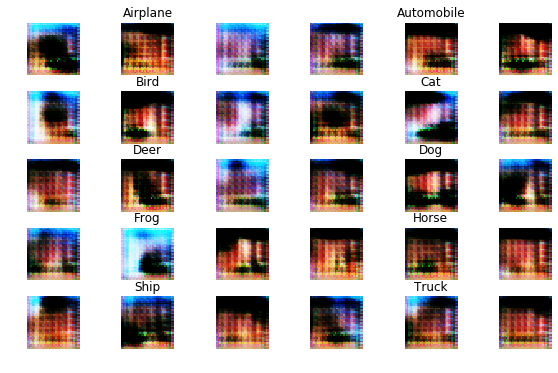

	Epoch: 42, Generator Loss: 0.005177448687553406, Discriminator Loss: [0.00109623 0.        ]


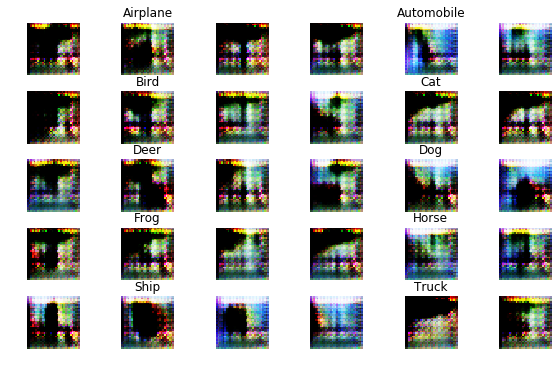

	Epoch: 43, Generator Loss: 0.008673311767578126, Discriminator Loss: [0.00131547 0.        ]


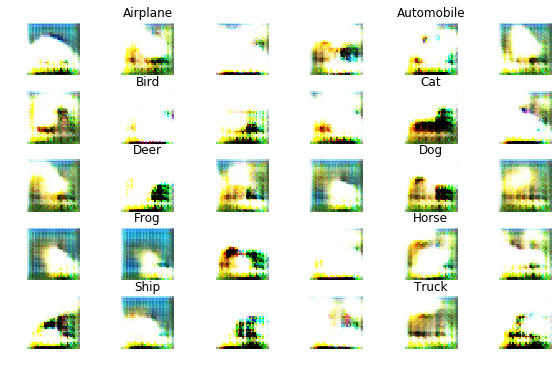

	Epoch: 44, Generator Loss: 0.007297257227897644, Discriminator Loss: [0.00165722 0.        ]


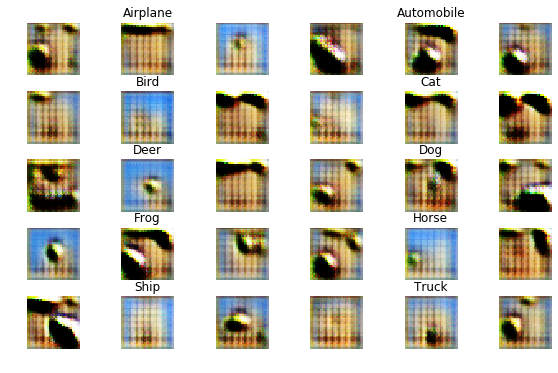

	Epoch: 45, Generator Loss: 0.007722547359466553, Discriminator Loss: [0.00141463 0.        ]


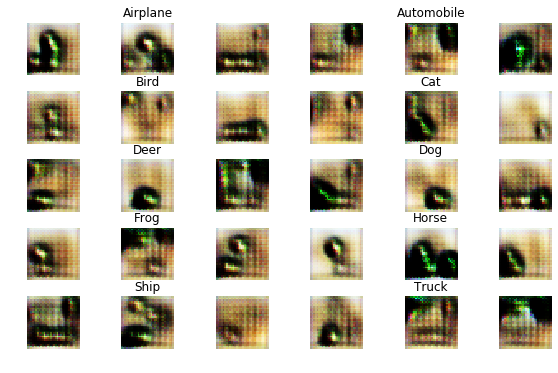

	Epoch: 46, Generator Loss: 0.01106815622329712, Discriminator Loss: [0.00130976 0.        ]


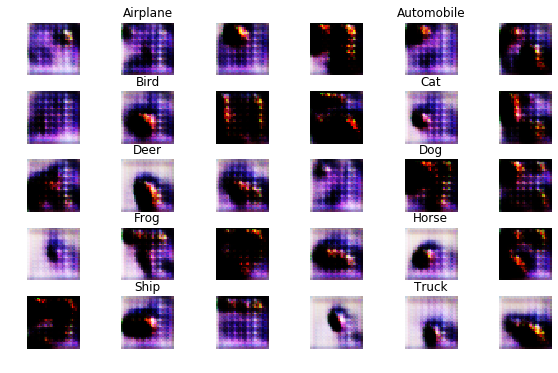

	Epoch: 47, Generator Loss: 0.012750760498046874, Discriminator Loss: [0.00124927 0.        ]


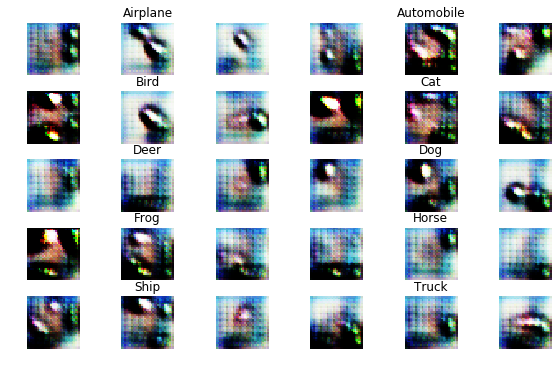

	Epoch: 48, Generator Loss: 0.008769857902526856, Discriminator Loss: [0.00119433 0.        ]


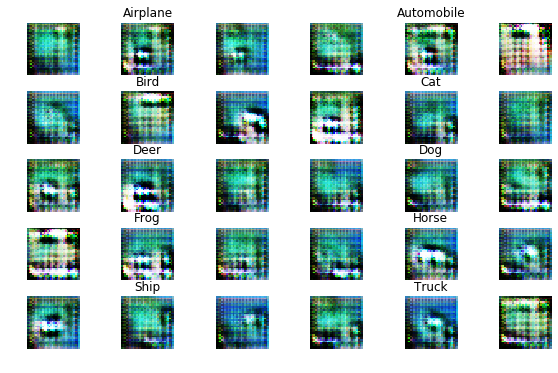

	Epoch: 49, Generator Loss: 0.010416807441711426, Discriminator Loss: [0.0012651 0.       ]


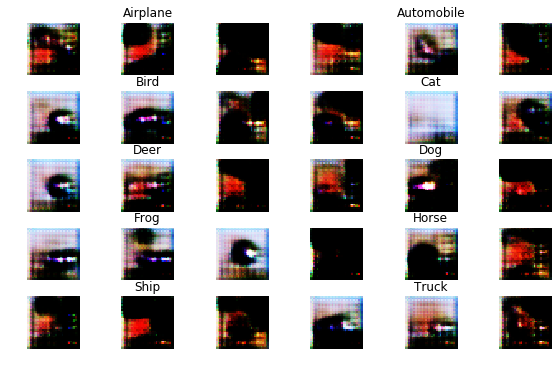

	Epoch: 50, Generator Loss: 0.008728849534988403, Discriminator Loss: [0.00130072 0.        ]


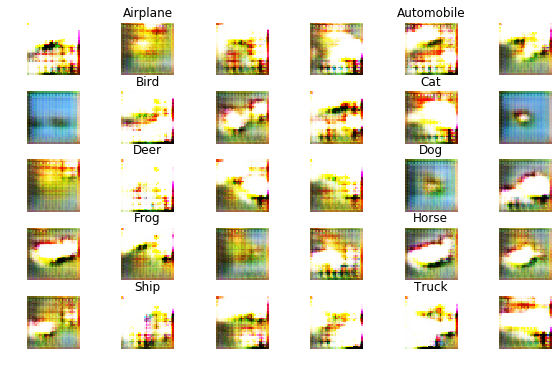

	Epoch: 51, Generator Loss: 0.009703276538848877, Discriminator Loss: [0.00143872 0.        ]


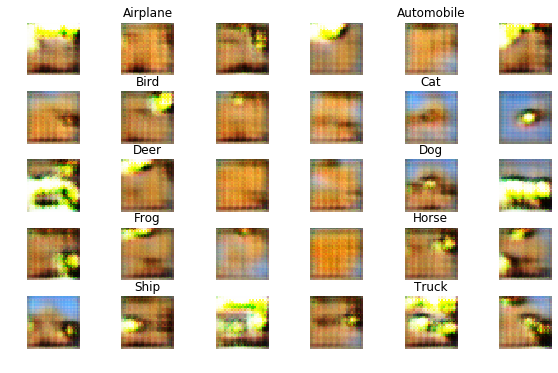

	Epoch: 52, Generator Loss: 0.012837521057128907, Discriminator Loss: [0.00159867 0.        ]


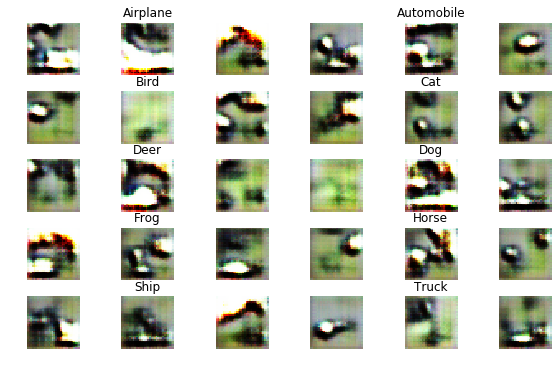

	Epoch: 53, Generator Loss: 0.011527136344909667, Discriminator Loss: [0.00141052 0.        ]


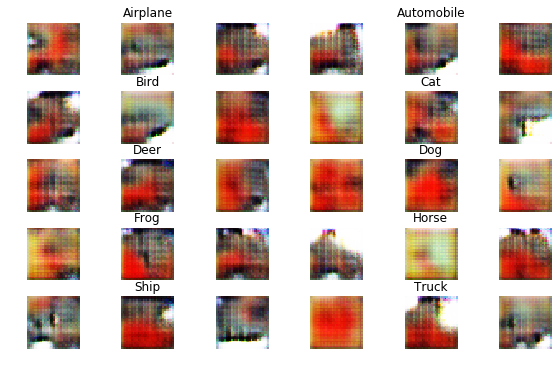

	Epoch: 54, Generator Loss: 0.011650183906555176, Discriminator Loss: [0.0014598 0.       ]


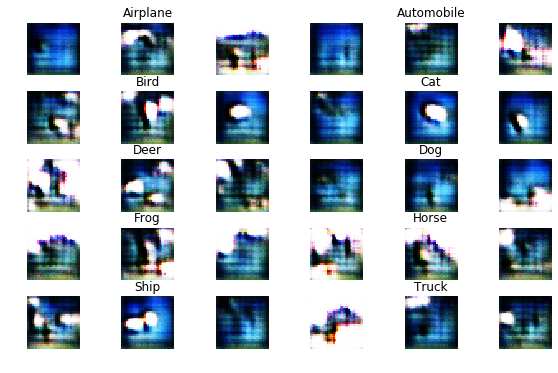

	Epoch: 55, Generator Loss: 0.010593590888977052, Discriminator Loss: [0.00119503 0.        ]


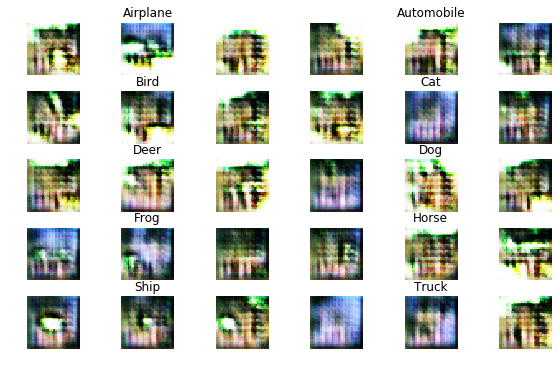

	Epoch: 56, Generator Loss: 0.009754867038726807, Discriminator Loss: [0.00133724 0.        ]


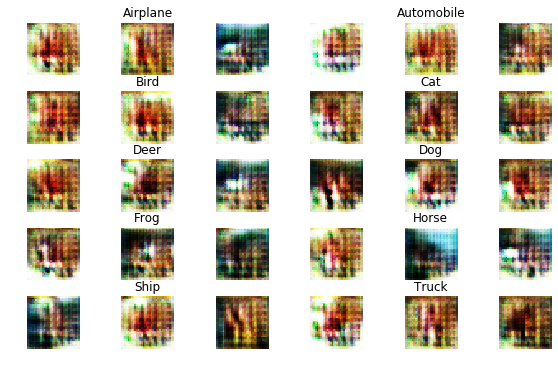

	Epoch: 57, Generator Loss: 0.012310939559936524, Discriminator Loss: [0.00130286 0.        ]


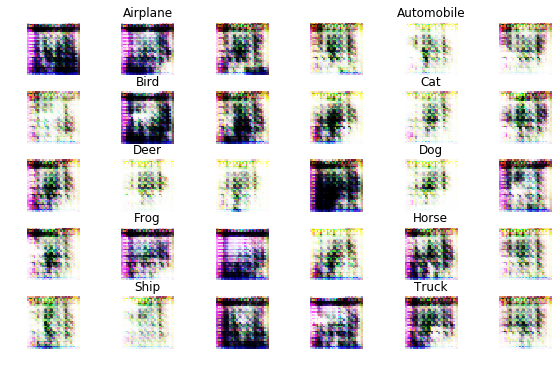

	Epoch: 58, Generator Loss: 0.01100298641204834, Discriminator Loss: [0.00106753 0.        ]


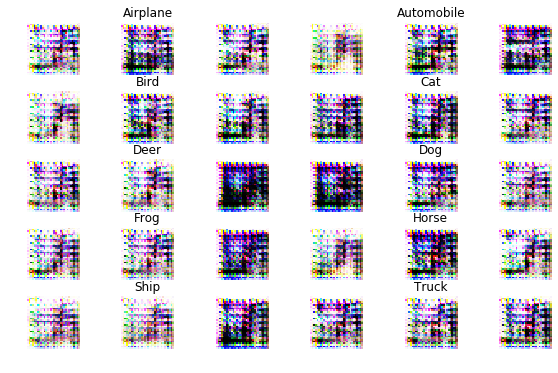

	Epoch: 59, Generator Loss: 0.012490269737243652, Discriminator Loss: [0.00106057 0.        ]


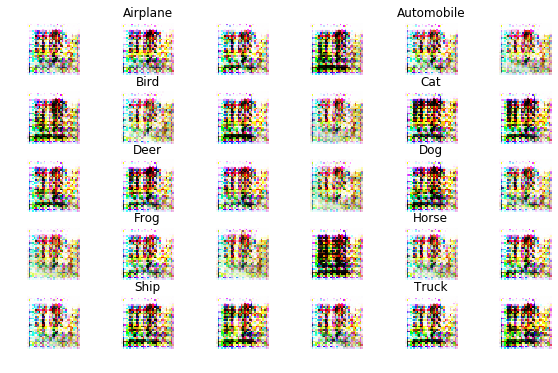

	Epoch: 60, Generator Loss: 0.01517636360168457, Discriminator Loss: [0.00109904 0.        ]


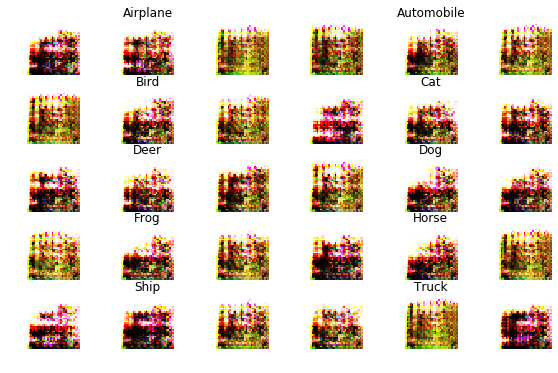

	Epoch: 61, Generator Loss: 0.007993449492454528, Discriminator Loss: [0.00106816 0.        ]


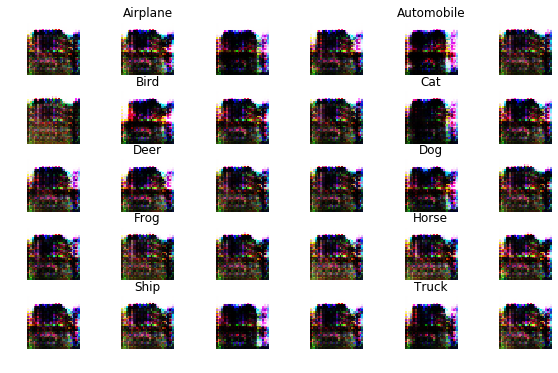

	Epoch: 62, Generator Loss: 0.012909933776855469, Discriminator Loss: [0.00107469 0.        ]


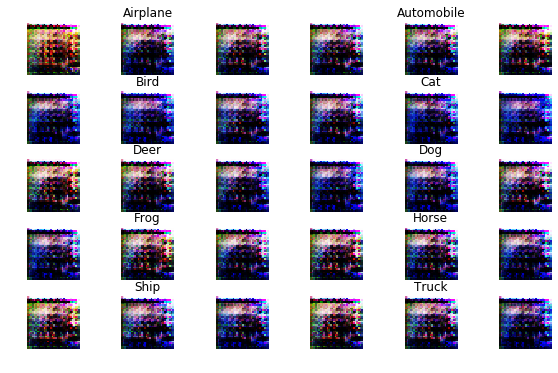

	Epoch: 63, Generator Loss: 0.010865394077301025, Discriminator Loss: [0.00104066 0.        ]


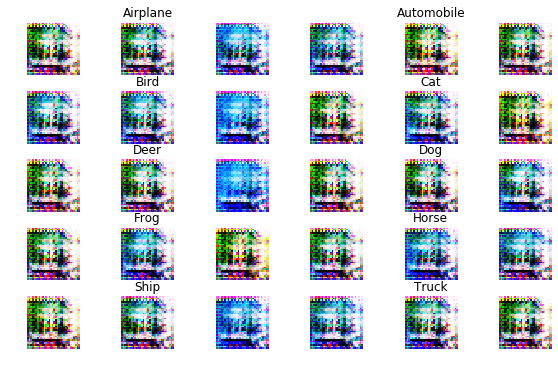

	Epoch: 64, Generator Loss: 0.014180998840332032, Discriminator Loss: [0.00104254 0.        ]


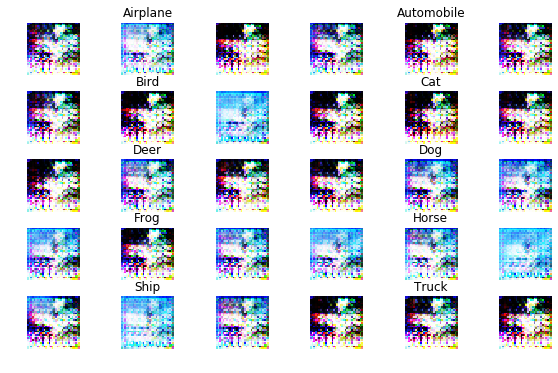

	Epoch: 65, Generator Loss: 0.007739281549453736, Discriminator Loss: [0.00102187 0.        ]


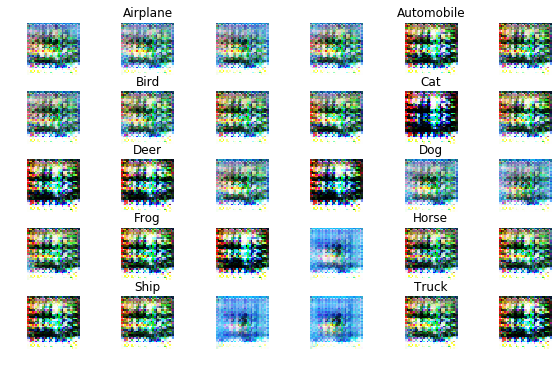

	Epoch: 66, Generator Loss: 0.01201984480857849, Discriminator Loss: [0.00121184 0.        ]


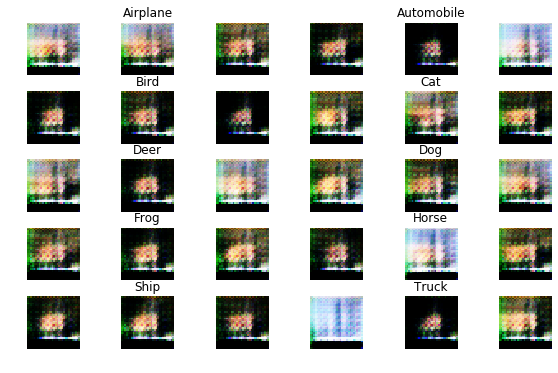

	Epoch: 67, Generator Loss: 0.010000572547912598, Discriminator Loss: [0.0011666 0.       ]


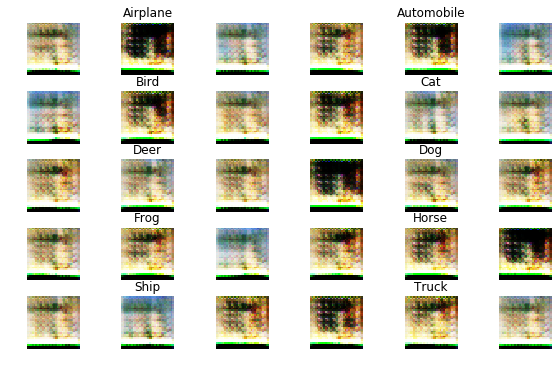

	Epoch: 68, Generator Loss: 0.009846999320983887, Discriminator Loss: [0.00105351 0.        ]


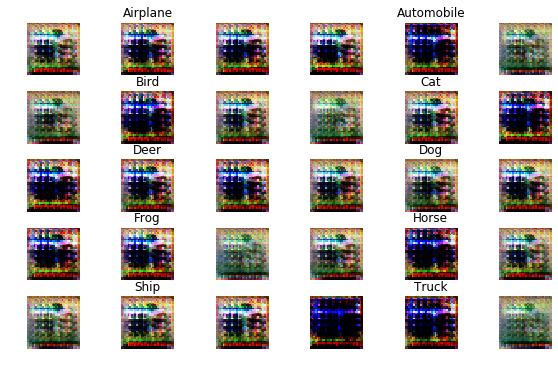

	Epoch: 69, Generator Loss: 0.013181577072143555, Discriminator Loss: [0.00108054 0.        ]


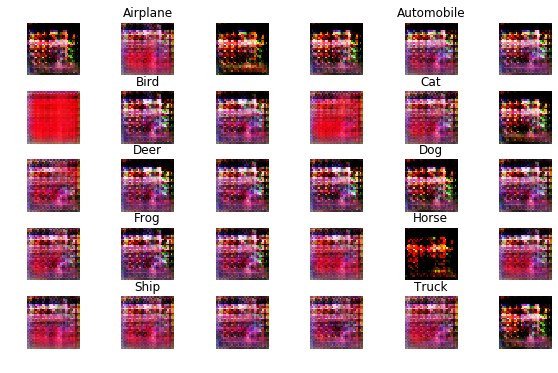

	Epoch: 70, Generator Loss: 0.005827006559371948, Discriminator Loss: [0.00108858 0.        ]


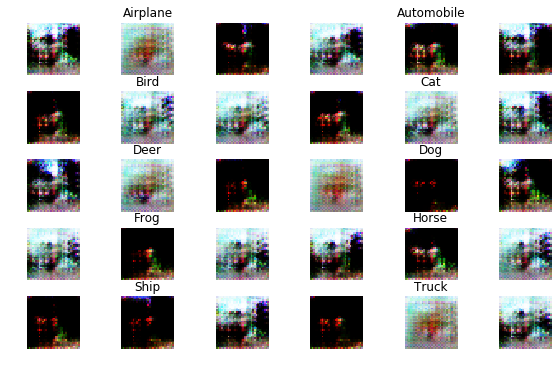

	Epoch: 71, Generator Loss: 0.007228801822662353, Discriminator Loss: [0.00124699 0.        ]


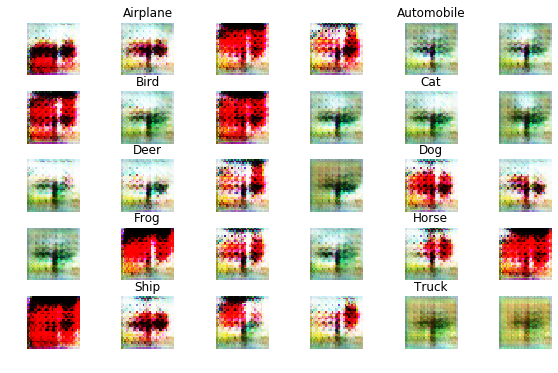

	Epoch: 72, Generator Loss: 0.009833046369552612, Discriminator Loss: [0.00171671 0.        ]


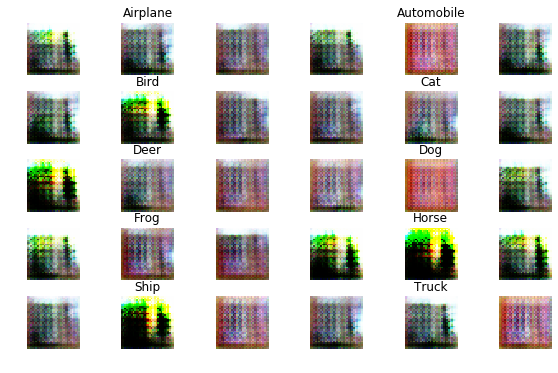

	Epoch: 73, Generator Loss: 0.00879908802986145, Discriminator Loss: [0.00133482 0.        ]


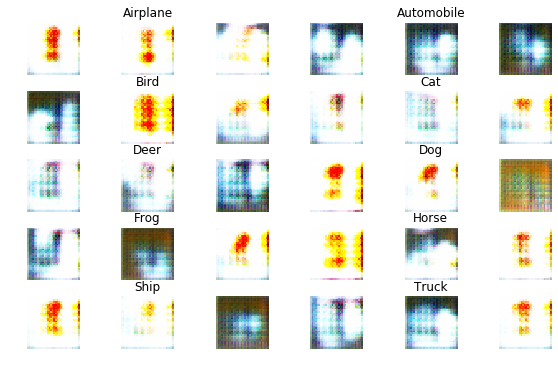

	Epoch: 74, Generator Loss: 0.010125598831176757, Discriminator Loss: [0.00141855 0.        ]


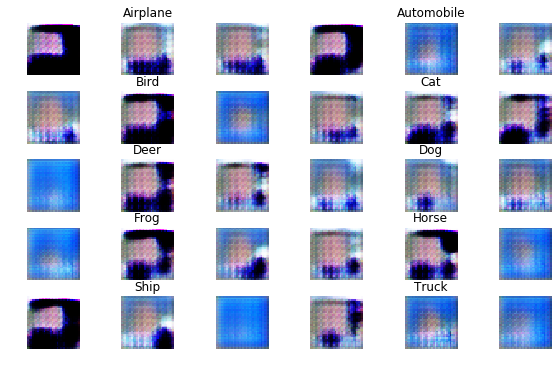

	Epoch: 75, Generator Loss: 0.00586065752029419, Discriminator Loss: [0.00120787 0.        ]


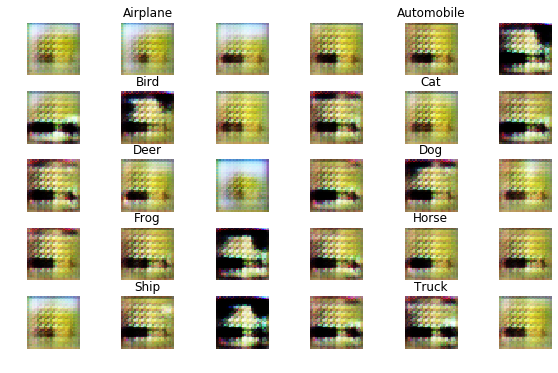

	Epoch: 76, Generator Loss: 0.007759654808044434, Discriminator Loss: [0.0011226 0.       ]


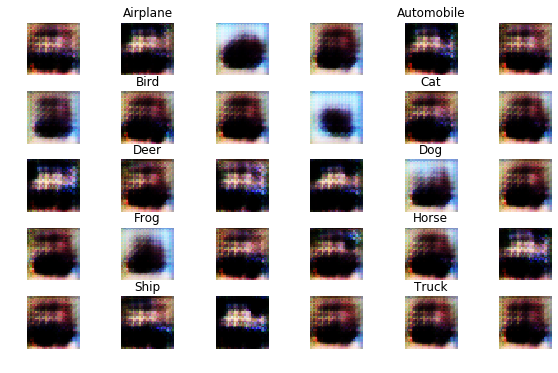

	Epoch: 77, Generator Loss: 0.009970708465576171, Discriminator Loss: [0.00107006 0.        ]


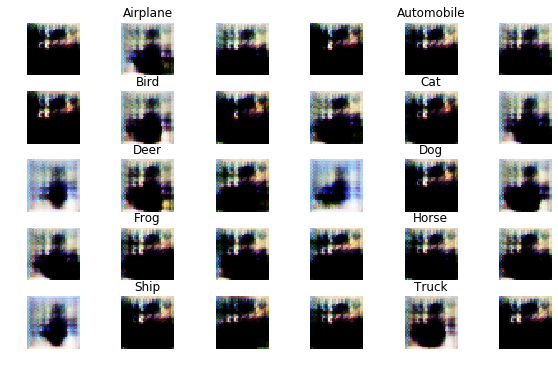

	Epoch: 78, Generator Loss: 0.01281698860168457, Discriminator Loss: [0.00126394 0.        ]


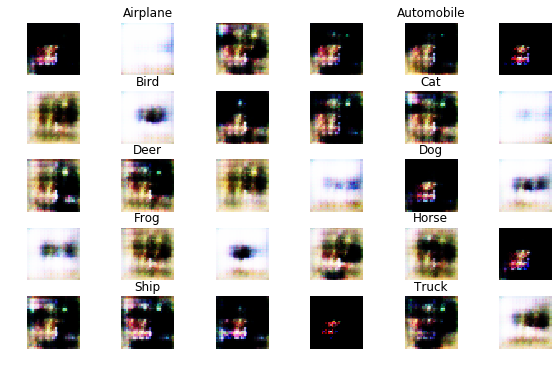

	Epoch: 79, Generator Loss: 0.013220416641235352, Discriminator Loss: [0.00115612 0.        ]


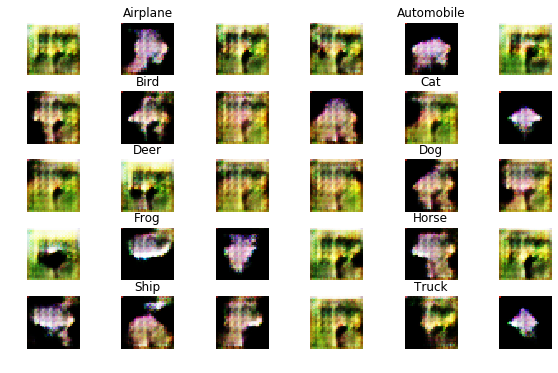

	Epoch: 80, Generator Loss: 0.009154224891662597, Discriminator Loss: [0.00117664 0.        ]


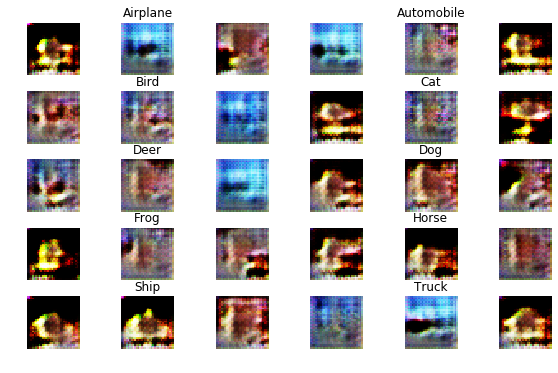

	Epoch: 81, Generator Loss: 0.007507861113548279, Discriminator Loss: [0.00123875 0.        ]


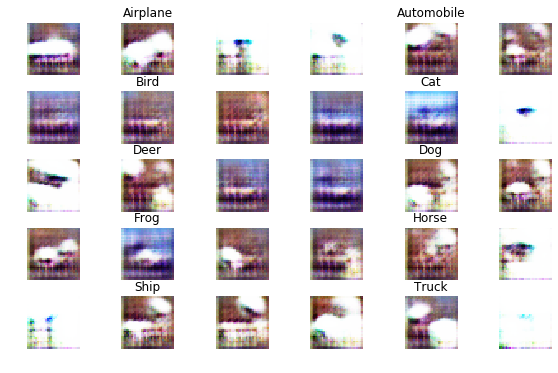

	Epoch: 82, Generator Loss: 0.010445148277282715, Discriminator Loss: [0.00130981 0.        ]


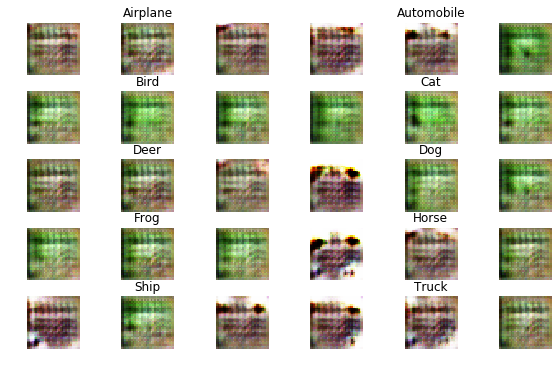

	Epoch: 83, Generator Loss: 0.011815081272125244, Discriminator Loss: [0.00129563 0.        ]


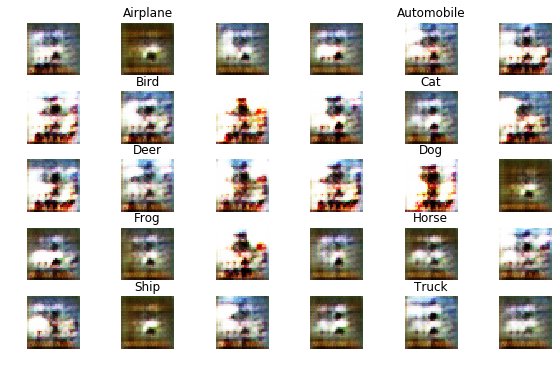

	Epoch: 84, Generator Loss: 0.00894832646369934, Discriminator Loss: [0.00110346 0.        ]


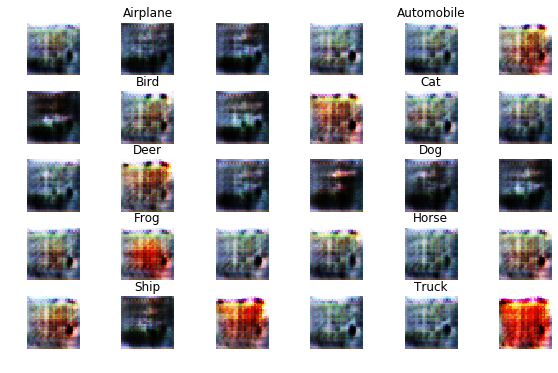

	Epoch: 85, Generator Loss: 0.0064730867576599125, Discriminator Loss: [0.00114117 0.        ]


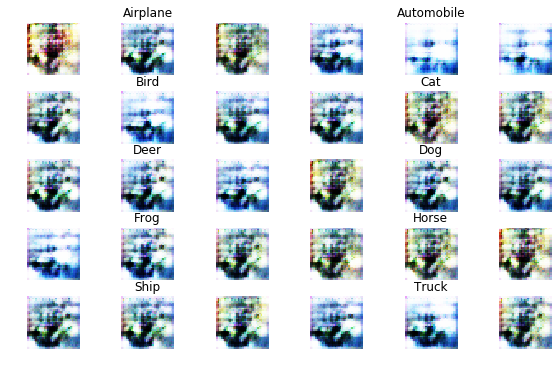

	Epoch: 86, Generator Loss: 0.013946698112487794, Discriminator Loss: [0.00104858 0.        ]


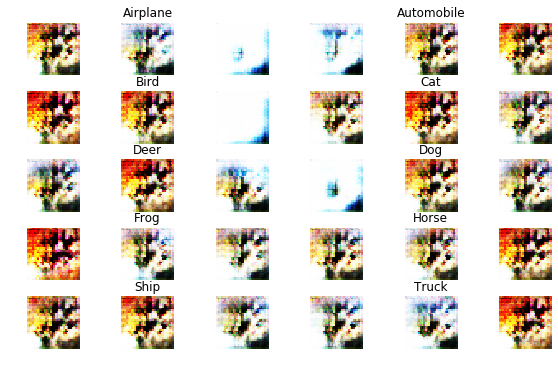

	Epoch: 87, Generator Loss: 0.014678022155761718, Discriminator Loss: [0.00104139 0.        ]


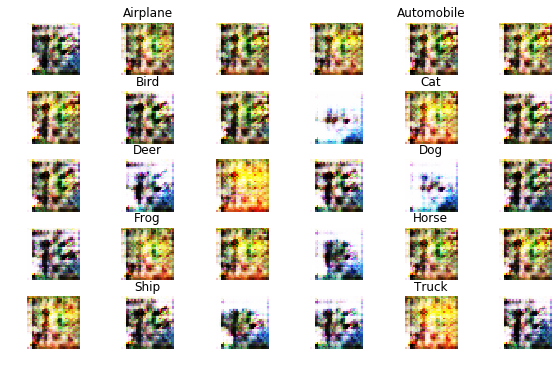

	Epoch: 88, Generator Loss: 0.016034840545654298, Discriminator Loss: [0.00110014 0.        ]


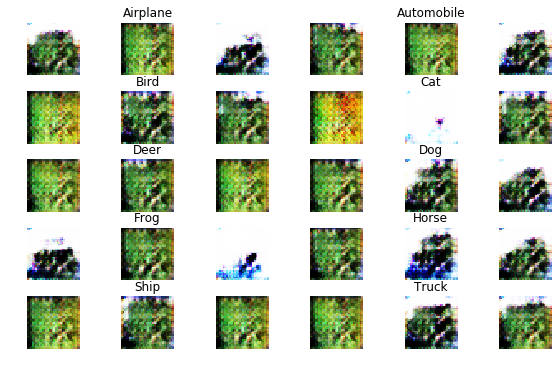

	Epoch: 89, Generator Loss: 0.014886411056518554, Discriminator Loss: [0.00130364 0.        ]


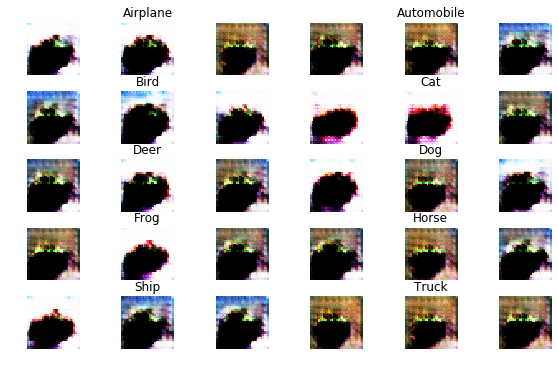

	Epoch: 90, Generator Loss: 0.004315840311050415, Discriminator Loss: [0.00109349 0.        ]


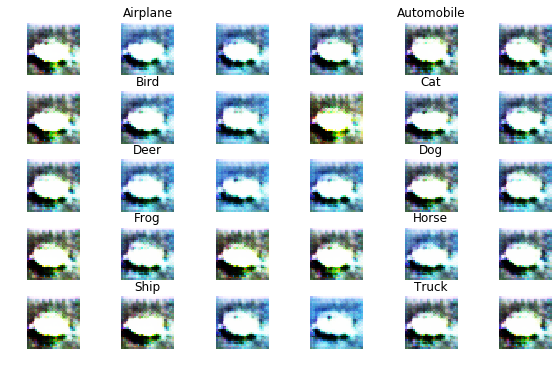

	Epoch: 91, Generator Loss: 0.011266601085662842, Discriminator Loss: [0.00112216 0.        ]


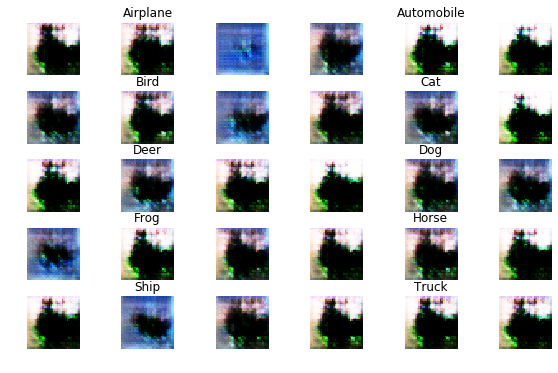

	Epoch: 92, Generator Loss: 0.01004339641571045, Discriminator Loss: [0.00106222 0.        ]


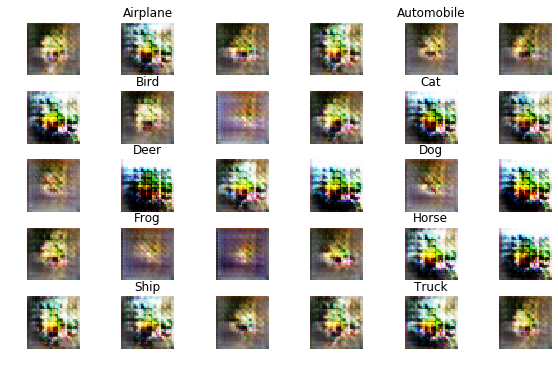

	Epoch: 93, Generator Loss: 0.011457070541381837, Discriminator Loss: [0.00134156 0.        ]


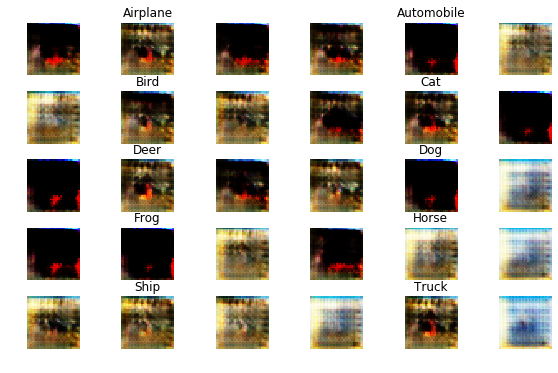

	Epoch: 94, Generator Loss: 0.012575753402709961, Discriminator Loss: [0.00109969 0.        ]


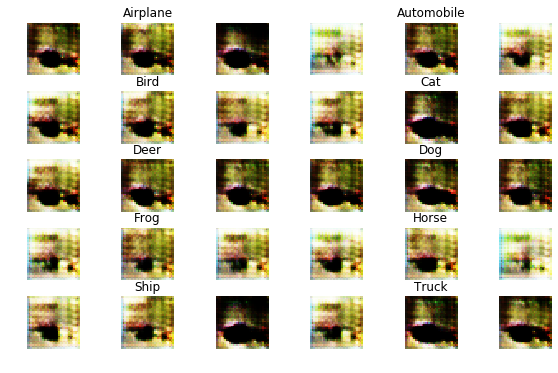

	Epoch: 95, Generator Loss: 0.01409343017578125, Discriminator Loss: [0.00121982 0.        ]


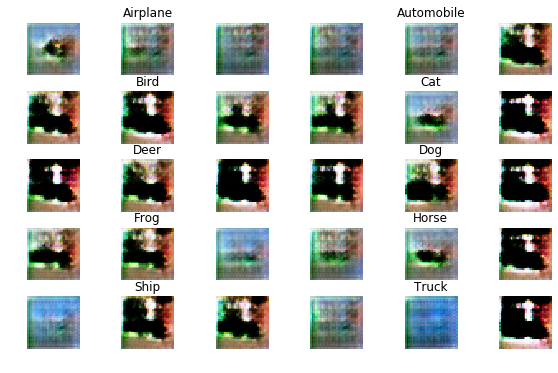

	Epoch: 96, Generator Loss: 0.005921164712905884, Discriminator Loss: [0.00111791 0.        ]


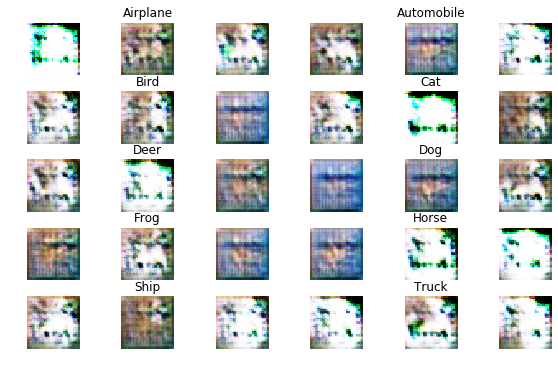

	Epoch: 97, Generator Loss: 0.009423905715942383, Discriminator Loss: [0.00114455 0.        ]


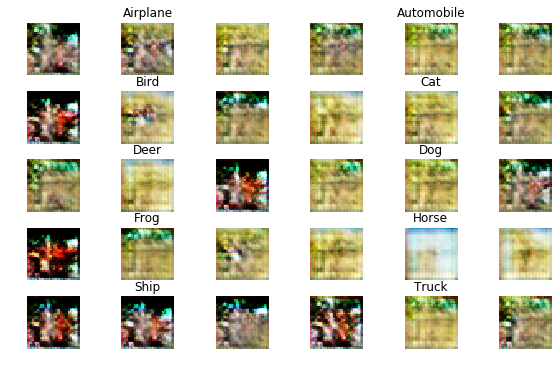

	Epoch: 98, Generator Loss: 0.011719511833190917, Discriminator Loss: [0.00182466 0.        ]


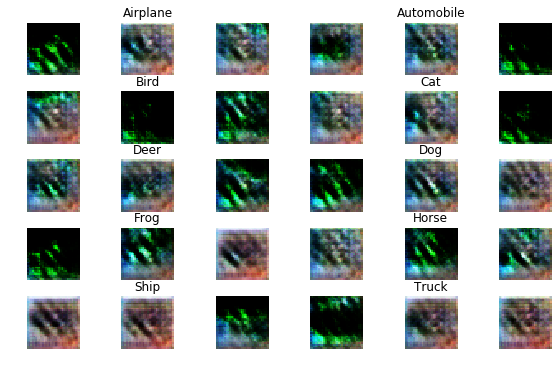

	Epoch: 99, Generator Loss: 0.009336463317871094, Discriminator Loss: [0.00128063 0.        ]


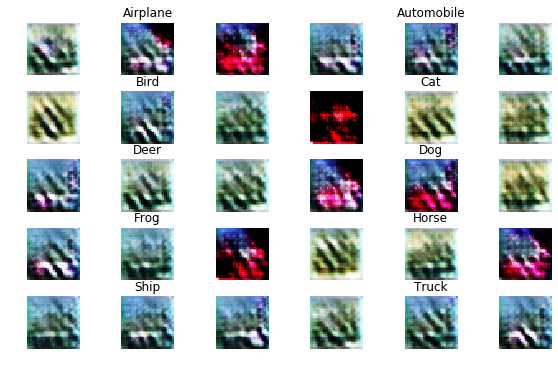

	Epoch: 100, Generator Loss: 0.0125603946685791, Discriminator Loss: [0.00118985 0.        ]


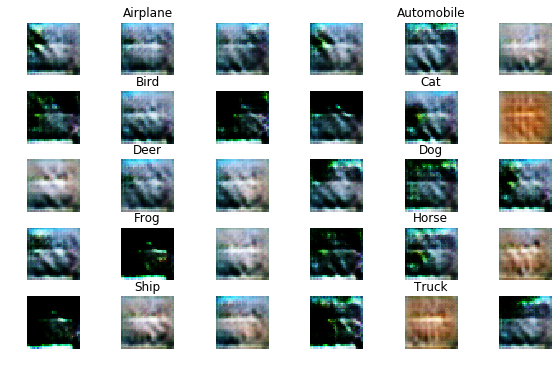

	Epoch: 101, Generator Loss: 0.008232384376525879, Discriminator Loss: [0.00130675 0.        ]


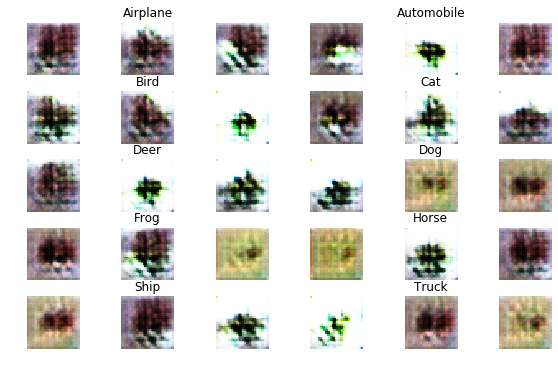

	Epoch: 102, Generator Loss: 0.012060582809448241, Discriminator Loss: [0.00122915 0.        ]


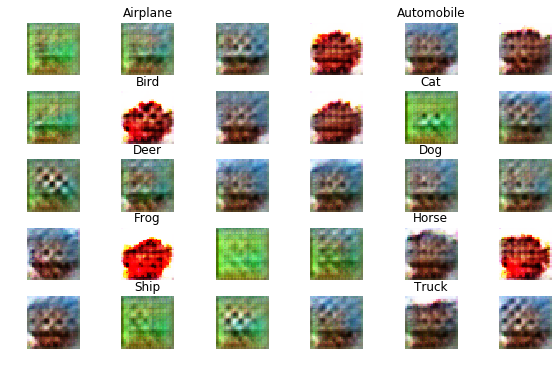

	Epoch: 103, Generator Loss: 0.009061032829284669, Discriminator Loss: [0.00117454 0.        ]


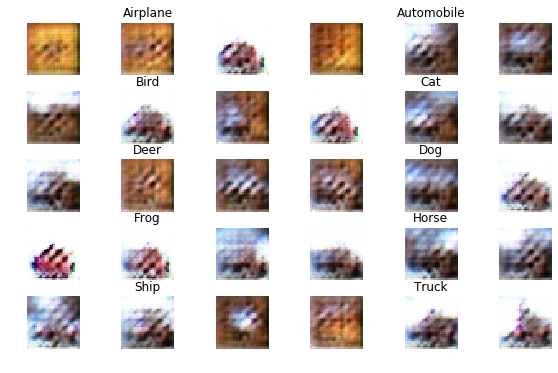

	Epoch: 104, Generator Loss: 0.008953661117553711, Discriminator Loss: [0.00127378 0.        ]


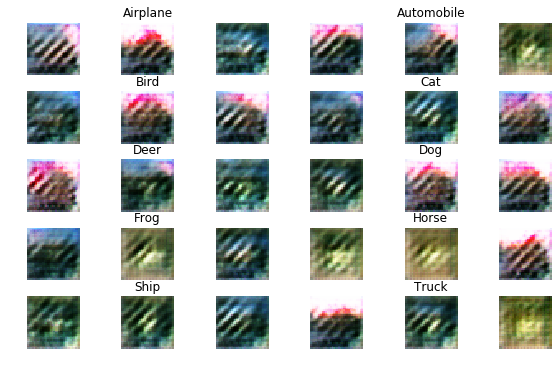

	Epoch: 105, Generator Loss: 0.006289320526123047, Discriminator Loss: [0.00111813 0.        ]


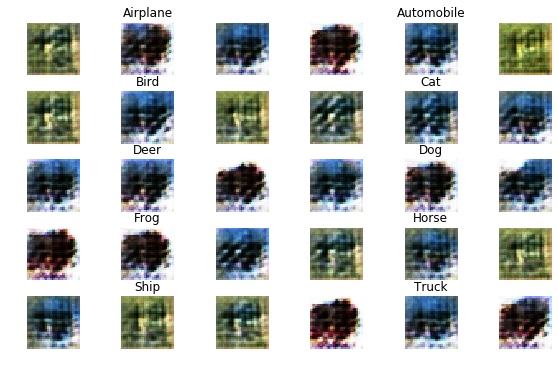

	Epoch: 106, Generator Loss: 0.008460493755340576, Discriminator Loss: [0.00118189 0.        ]


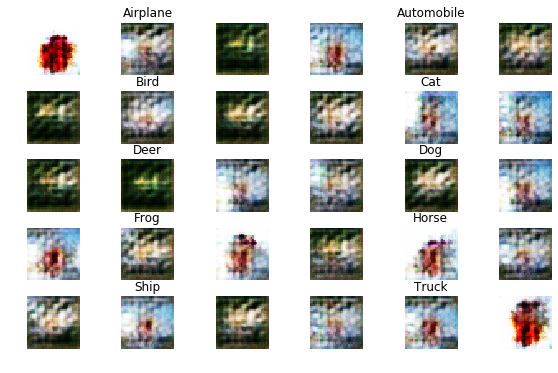

	Epoch: 107, Generator Loss: 0.008633536739349365, Discriminator Loss: [0.00112704 0.        ]


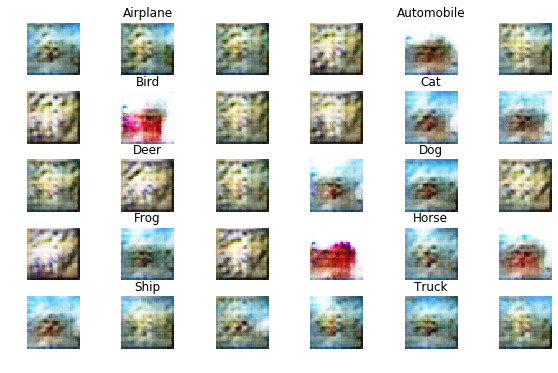

	Epoch: 108, Generator Loss: 0.01036201587677002, Discriminator Loss: [0.001233 0.      ]


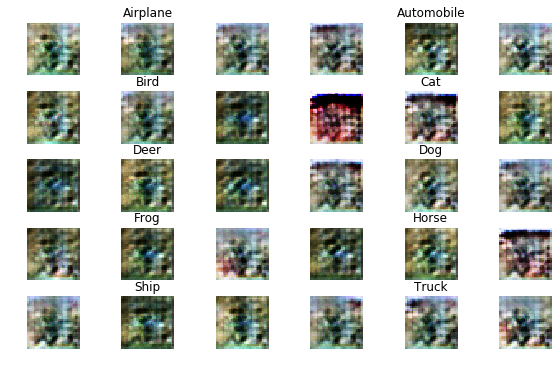

	Epoch: 109, Generator Loss: 0.00801711814880371, Discriminator Loss: [0.00113283 0.        ]


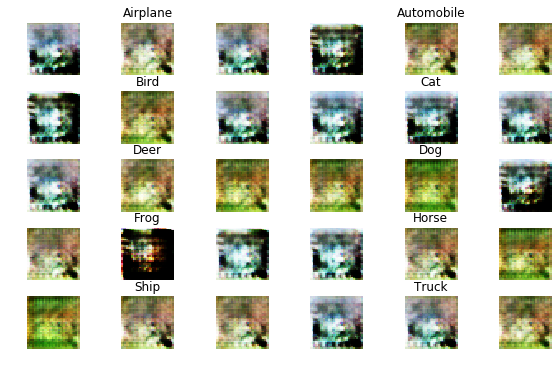

	Epoch: 110, Generator Loss: 0.009385440349578857, Discriminator Loss: [0.00125677 0.        ]


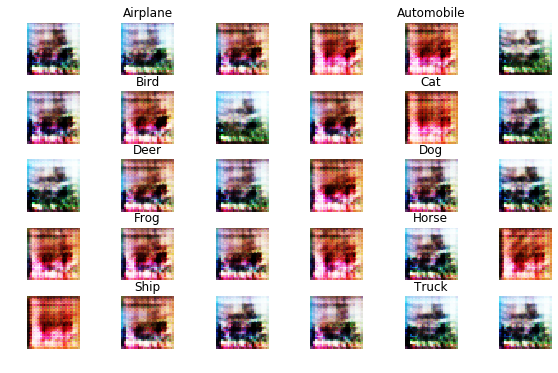

	Epoch: 111, Generator Loss: 0.0115986767578125, Discriminator Loss: [0.0011143 0.       ]


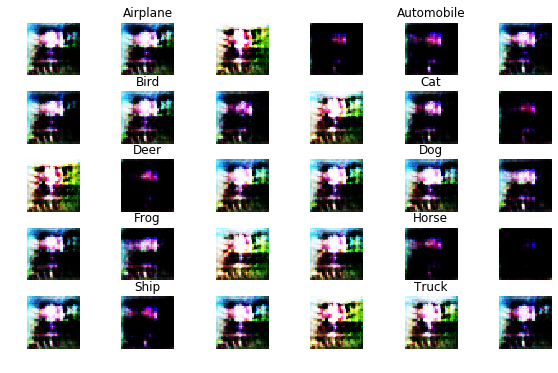

	Epoch: 112, Generator Loss: 0.011864177665710449, Discriminator Loss: [0.00114294 0.        ]


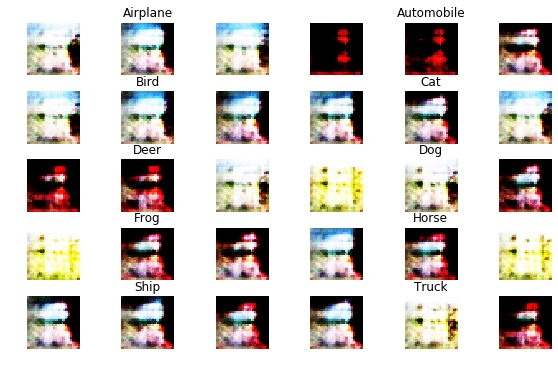

	Epoch: 113, Generator Loss: 0.011400523719787597, Discriminator Loss: [0.00105627 0.        ]


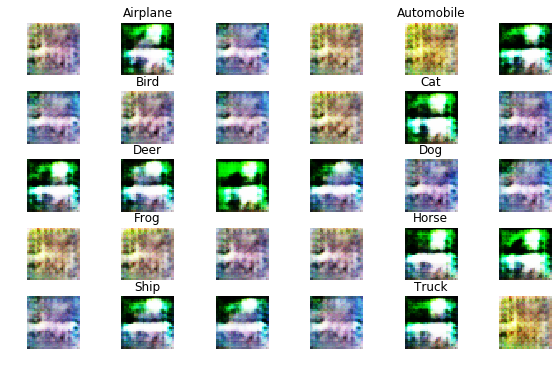

	Epoch: 114, Generator Loss: 0.01172053129196167, Discriminator Loss: [0.00118185 0.        ]


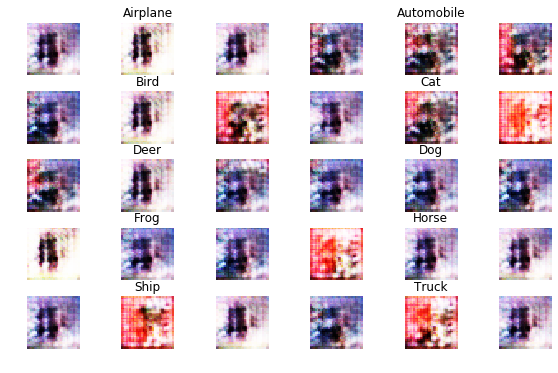

	Epoch: 115, Generator Loss: 0.011868945846557618, Discriminator Loss: [0.00110732 0.        ]


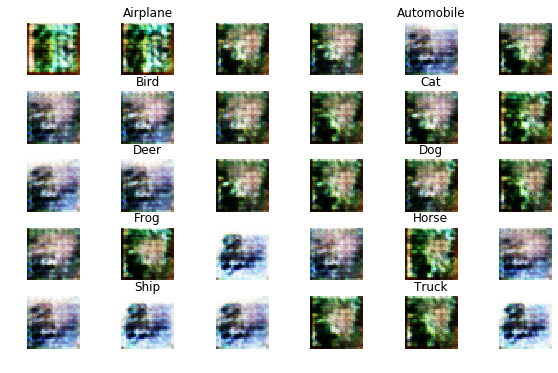

	Epoch: 116, Generator Loss: 0.010773700637817383, Discriminator Loss: [0.00102223 0.        ]


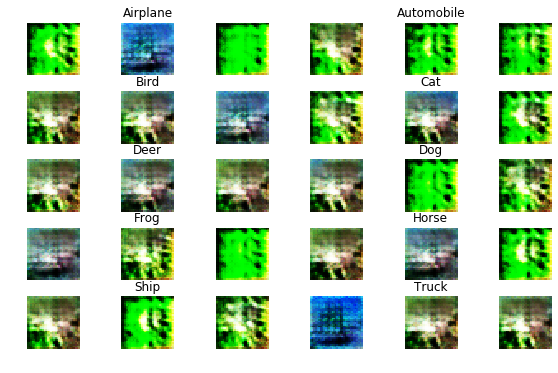

	Epoch: 117, Generator Loss: 0.00993858325958252, Discriminator Loss: [0.00112678 0.        ]


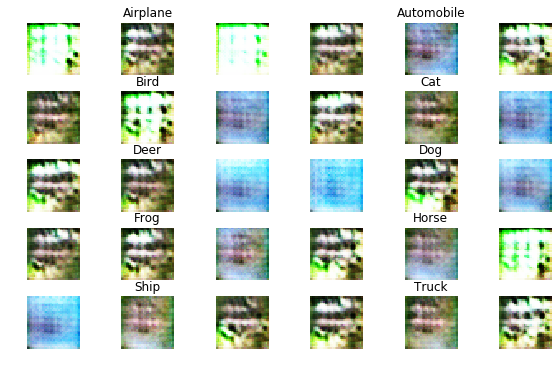

	Epoch: 118, Generator Loss: 0.013756442642211915, Discriminator Loss: [0.00127074 0.        ]


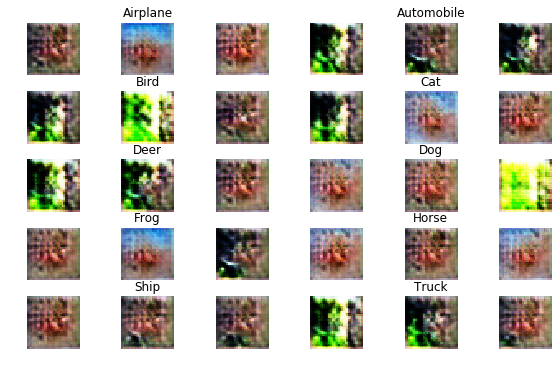

	Epoch: 119, Generator Loss: 0.011908700485229491, Discriminator Loss: [0.00109306 0.        ]


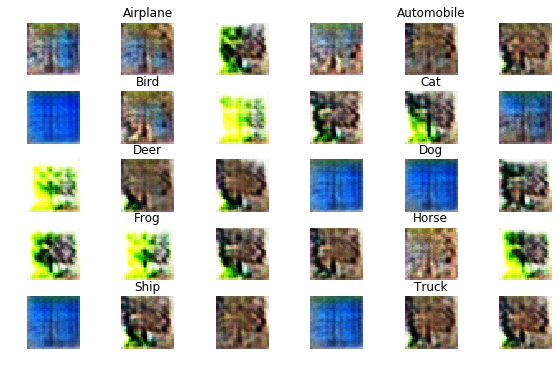

	Epoch: 120, Generator Loss: 0.013337587852478027, Discriminator Loss: [0.00120324 0.        ]


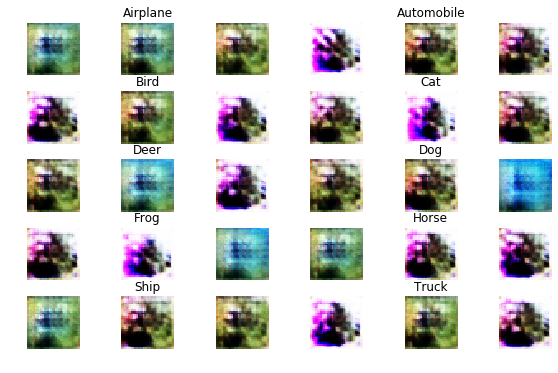

	Epoch: 121, Generator Loss: 0.013494326858520507, Discriminator Loss: [0.00115512 0.        ]


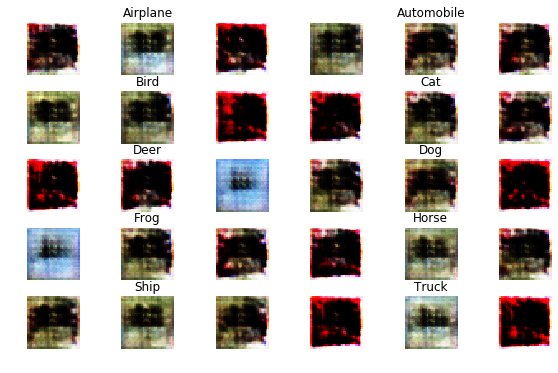

	Epoch: 122, Generator Loss: 0.010983801498413086, Discriminator Loss: [0.0011241 0.       ]


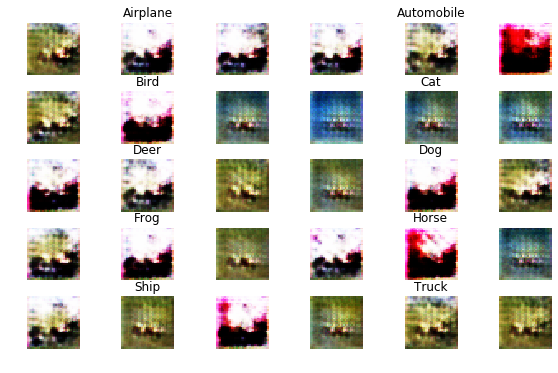

	Epoch: 123, Generator Loss: 0.012820007705688476, Discriminator Loss: [0.00110122 0.        ]


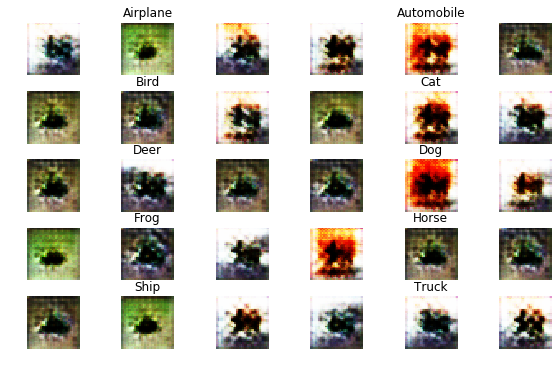

	Epoch: 124, Generator Loss: 0.01462879753112793, Discriminator Loss: [0.00121648 0.        ]


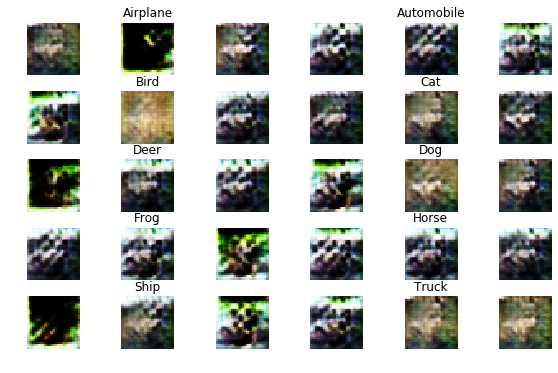

	Epoch: 125, Generator Loss: 0.011425187149047852, Discriminator Loss: [0.00108541 0.        ]


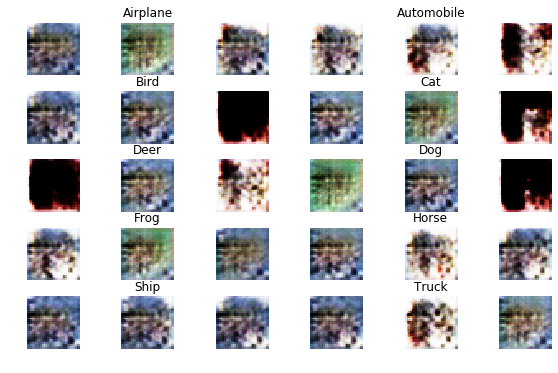

	Epoch: 126, Generator Loss: 0.01378452507019043, Discriminator Loss: [0.0010705 0.       ]


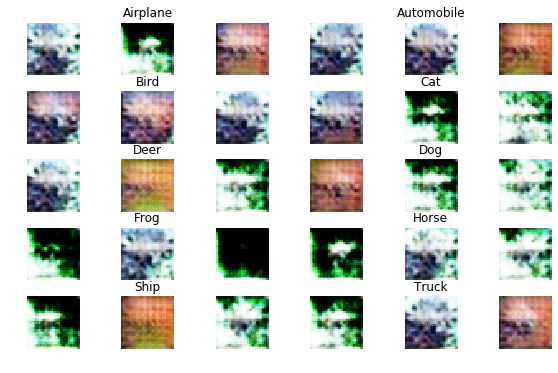

	Epoch: 127, Generator Loss: 0.010174059143066407, Discriminator Loss: [0.00109776 0.        ]


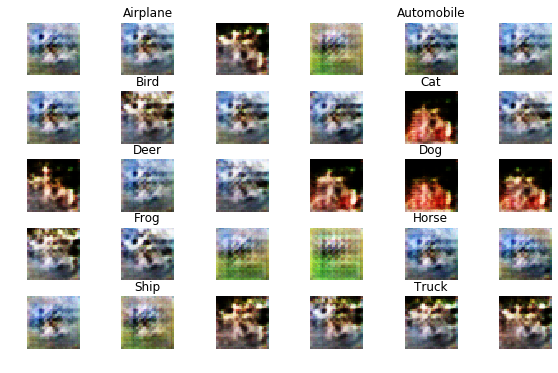

	Epoch: 128, Generator Loss: 0.012875142059326172, Discriminator Loss: [0.00108794 0.        ]


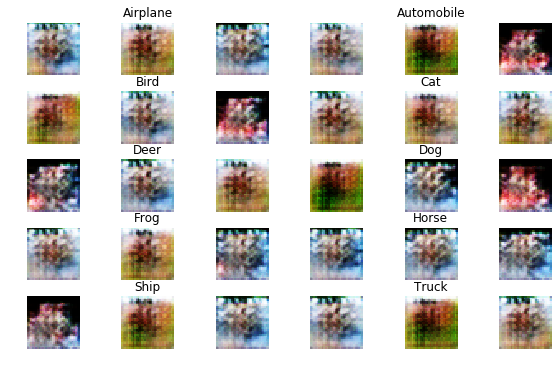

	Epoch: 129, Generator Loss: 0.014390133209228516, Discriminator Loss: [0.00112234 0.        ]


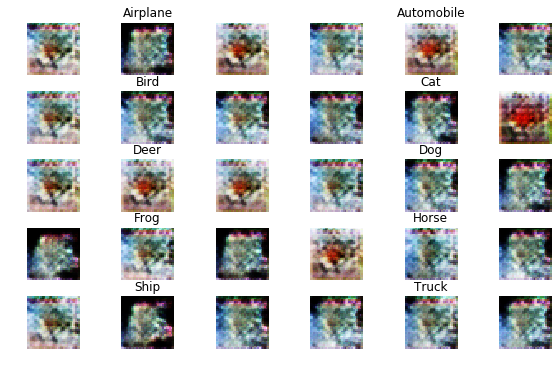

	Epoch: 130, Generator Loss: 0.012086277084350587, Discriminator Loss: [0.00108137 0.        ]


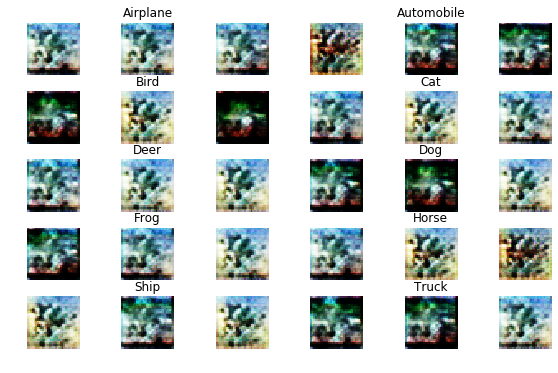

	Epoch: 131, Generator Loss: 0.014056419372558594, Discriminator Loss: [0.00106711 0.        ]


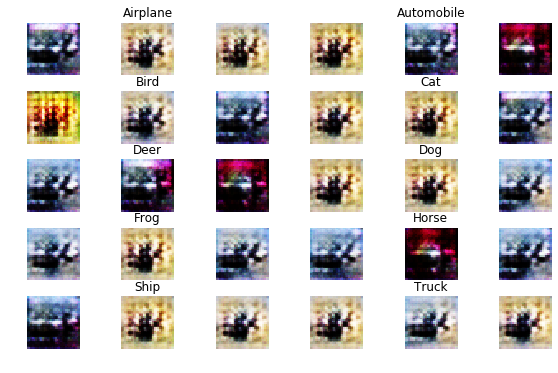

	Epoch: 132, Generator Loss: 0.01353488899230957, Discriminator Loss: [0.00107097 0.        ]


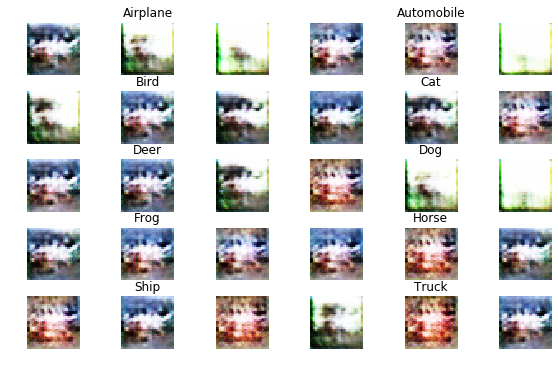

	Epoch: 133, Generator Loss: 0.0132086572265625, Discriminator Loss: [0.00107672 0.        ]


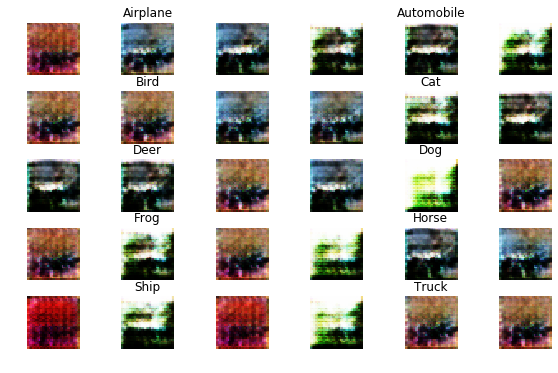

	Epoch: 134, Generator Loss: 0.010904250907897949, Discriminator Loss: [0.00115858 0.        ]


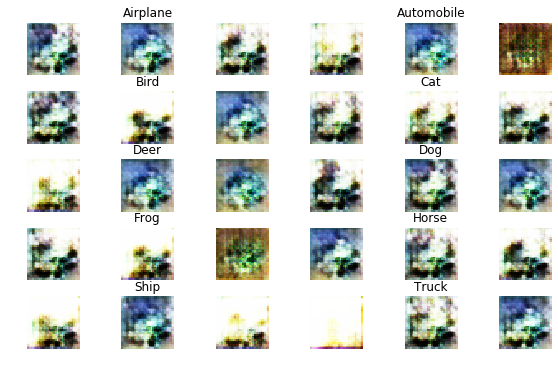

	Epoch: 135, Generator Loss: 0.012232339897155761, Discriminator Loss: [0.00115302 0.        ]


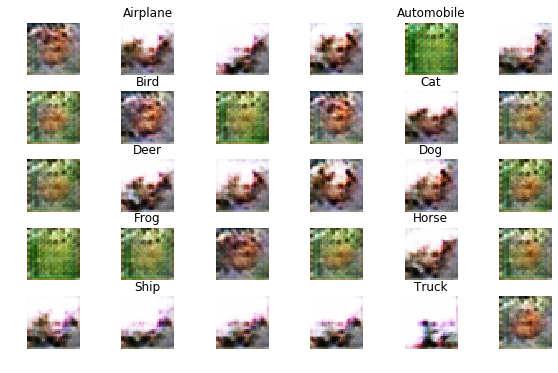

	Epoch: 136, Generator Loss: 0.01369295440673828, Discriminator Loss: [0.00112664 0.        ]


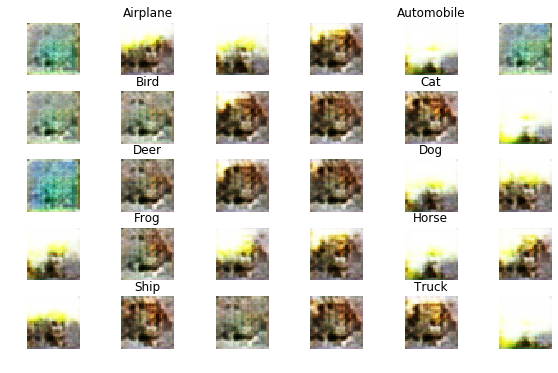

	Epoch: 137, Generator Loss: 0.014124705276489258, Discriminator Loss: [0.00114274 0.        ]


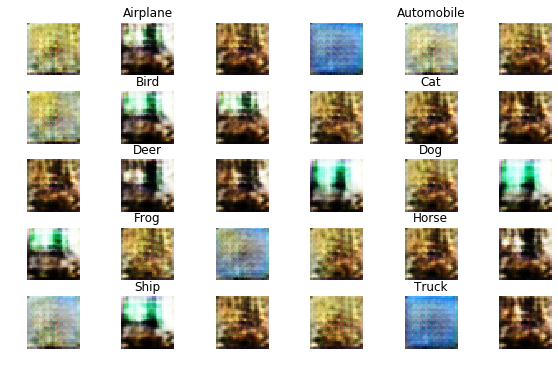

	Epoch: 138, Generator Loss: 0.00847481601715088, Discriminator Loss: [0.00103439 0.        ]


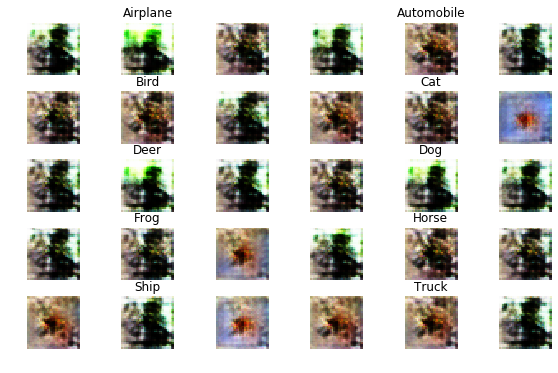

	Epoch: 139, Generator Loss: 0.014672250556945802, Discriminator Loss: [0.00115553 0.        ]


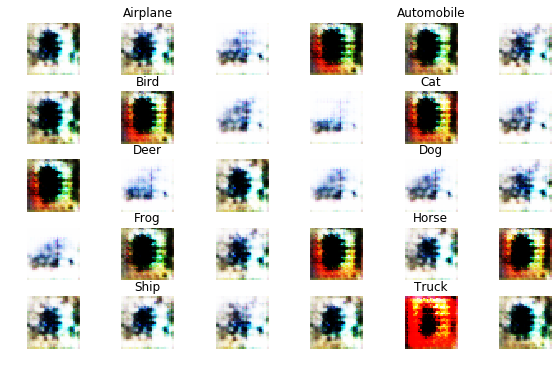

	Epoch: 140, Generator Loss: 0.013325240631103515, Discriminator Loss: [0.00102194 0.        ]


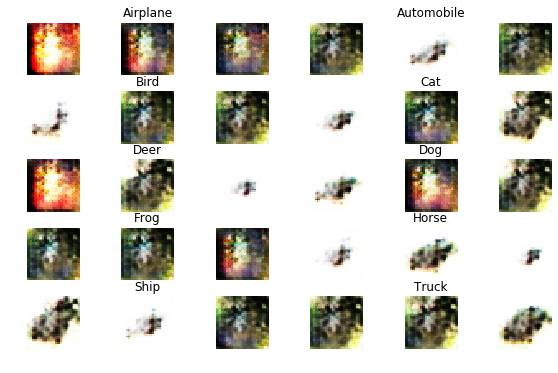

	Epoch: 141, Generator Loss: 0.012401968193054199, Discriminator Loss: [0.00115903 0.        ]


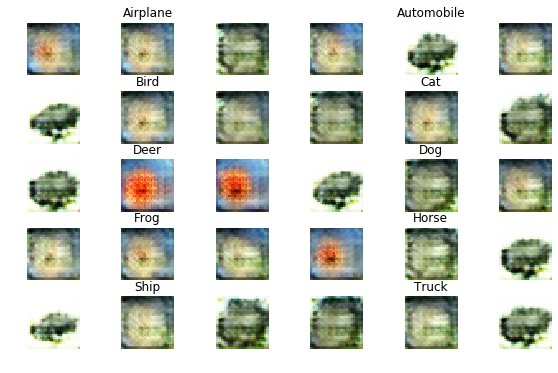

	Epoch: 142, Generator Loss: 0.012164604682922363, Discriminator Loss: [0.00107181 0.        ]


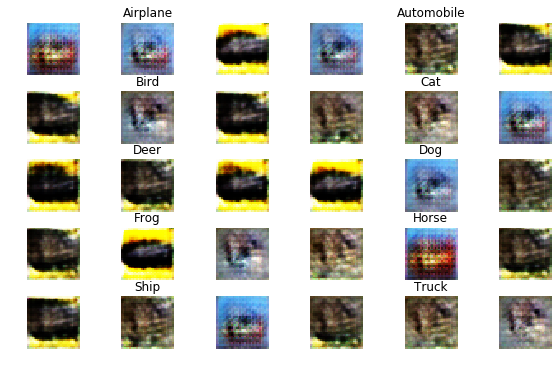

	Epoch: 143, Generator Loss: 0.013136244239807129, Discriminator Loss: [0.00119055 0.        ]


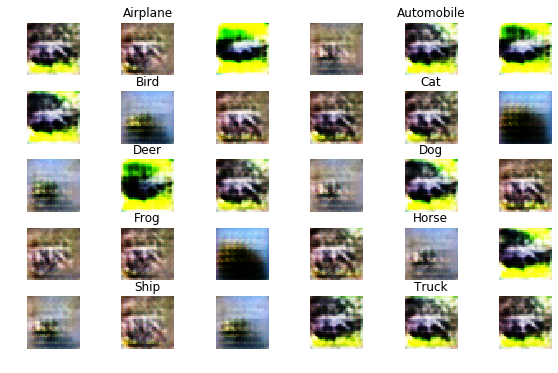

	Epoch: 144, Generator Loss: 0.013547876052856445, Discriminator Loss: [0.00104175 0.        ]


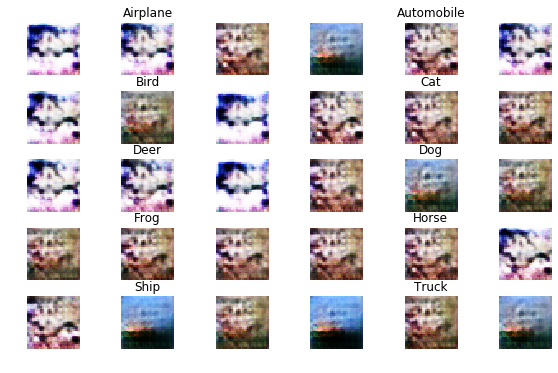

	Epoch: 145, Generator Loss: 0.014470646286010741, Discriminator Loss: [0.00107915 0.        ]


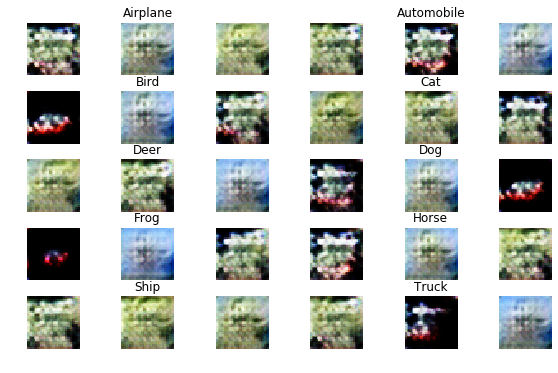

	Epoch: 146, Generator Loss: 0.013709920120239258, Discriminator Loss: [0.00103913 0.        ]


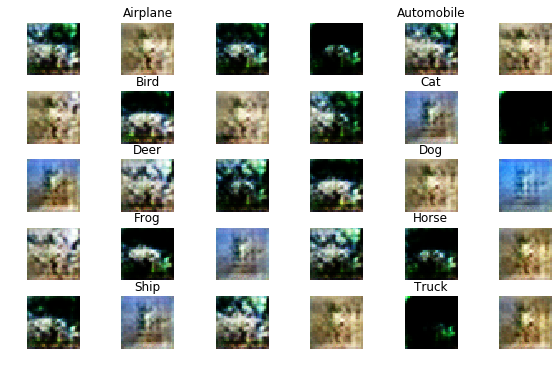

	Epoch: 147, Generator Loss: 0.013337271499633789, Discriminator Loss: [0.00114478 0.        ]


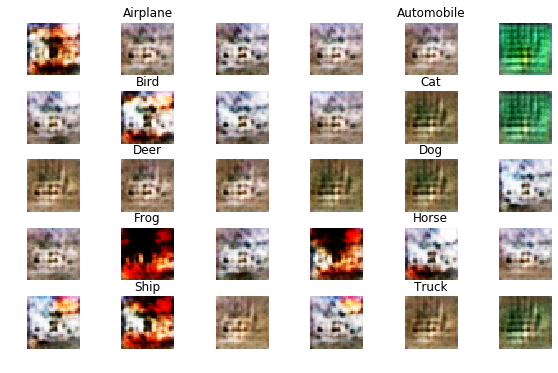

	Epoch: 148, Generator Loss: 0.01246516242980957, Discriminator Loss: [0.00107983 0.        ]


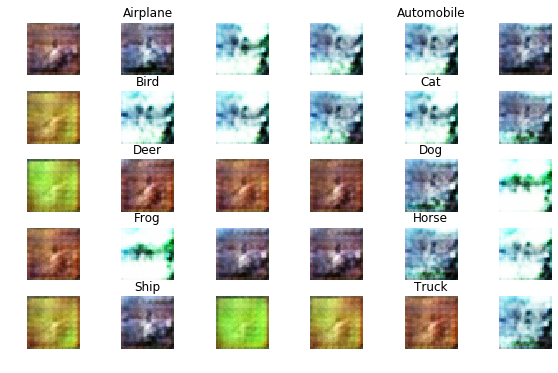

	Epoch: 149, Generator Loss: 0.013062177658081054, Discriminator Loss: [0.00115851 0.        ]


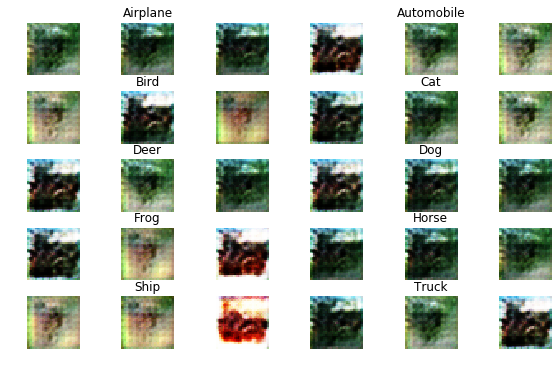

	Epoch: 150, Generator Loss: 0.010601320114135742, Discriminator Loss: [0.00108271 0.        ]


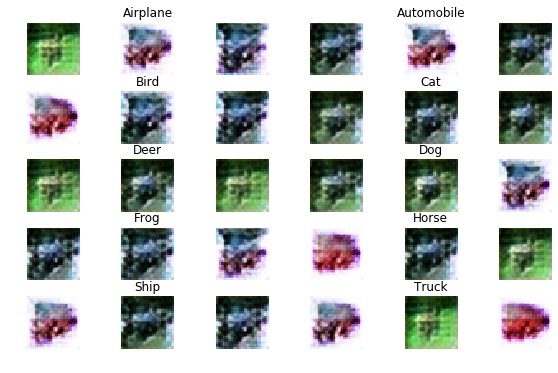

	Epoch: 151, Generator Loss: 0.01350218479156494, Discriminator Loss: [0.00110814 0.        ]


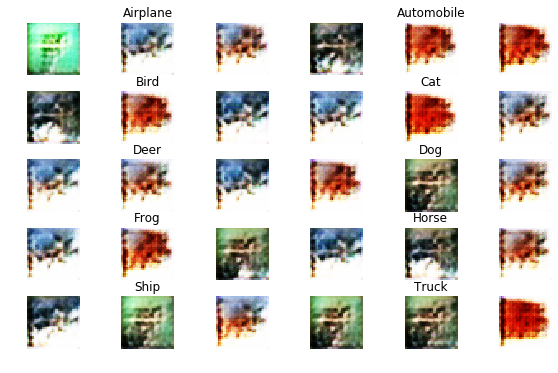

	Epoch: 152, Generator Loss: 0.013778974151611329, Discriminator Loss: [0.00104365 0.        ]


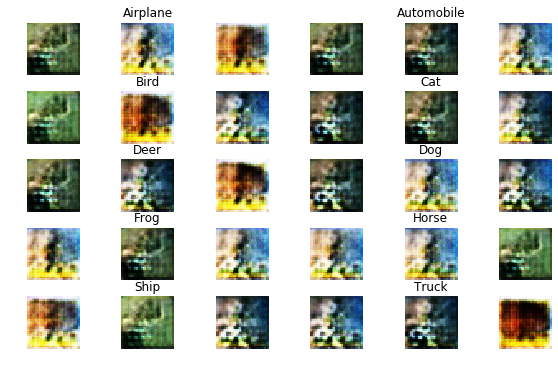

	Epoch: 153, Generator Loss: 0.012897608604431152, Discriminator Loss: [0.00108103 0.        ]


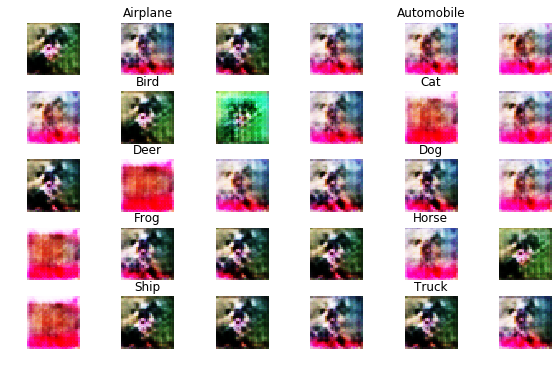

	Epoch: 154, Generator Loss: 0.014047430267333984, Discriminator Loss: [0.00105532 0.        ]


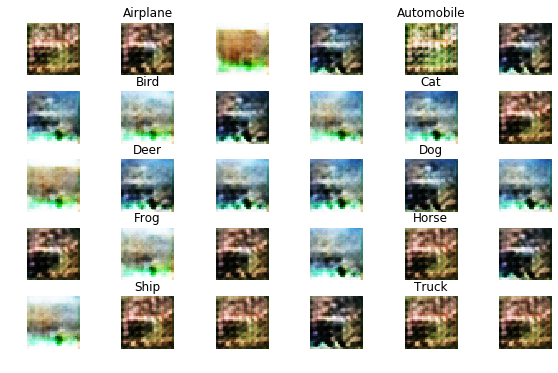

	Epoch: 155, Generator Loss: 0.013862397079467773, Discriminator Loss: [0.00106259 0.        ]


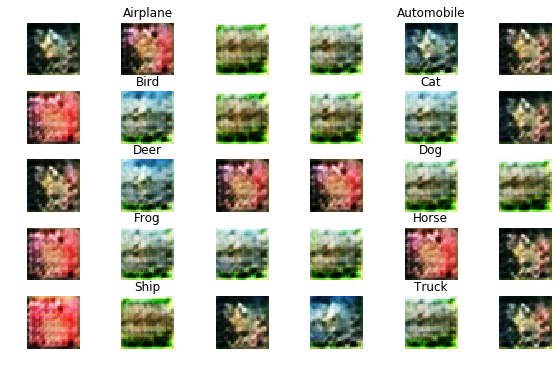

	Epoch: 156, Generator Loss: 0.011044193153381348, Discriminator Loss: [0.0010978 0.       ]


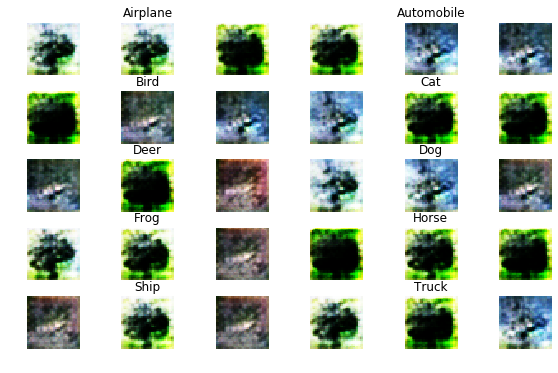

	Epoch: 157, Generator Loss: 0.012831751708984375, Discriminator Loss: [0.00109249 0.        ]


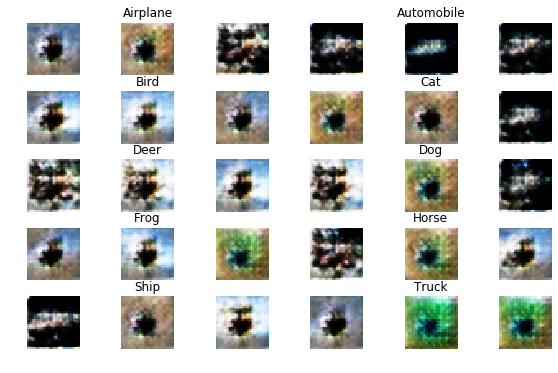

	Epoch: 158, Generator Loss: 0.011611422386169433, Discriminator Loss: [0.00115545 0.        ]


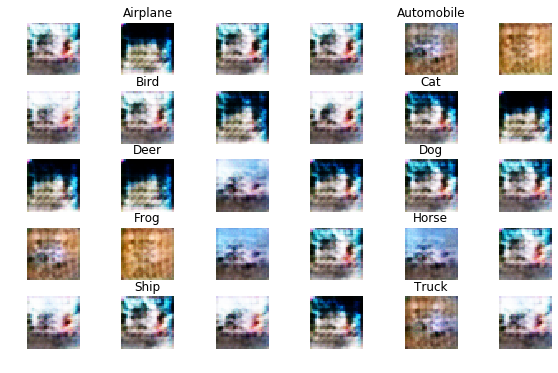

	Epoch: 159, Generator Loss: 0.012050352249145508, Discriminator Loss: [0.00110595 0.        ]


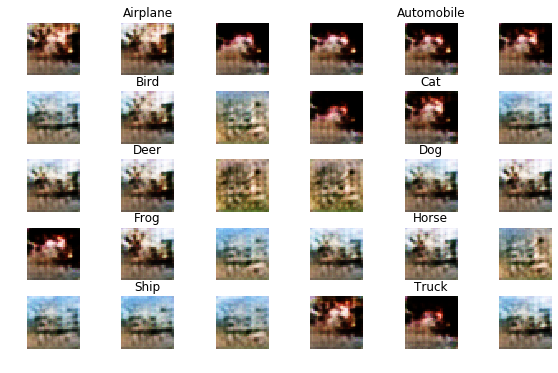

	Epoch: 160, Generator Loss: 0.011822648468017578, Discriminator Loss: [0.00108109 0.        ]


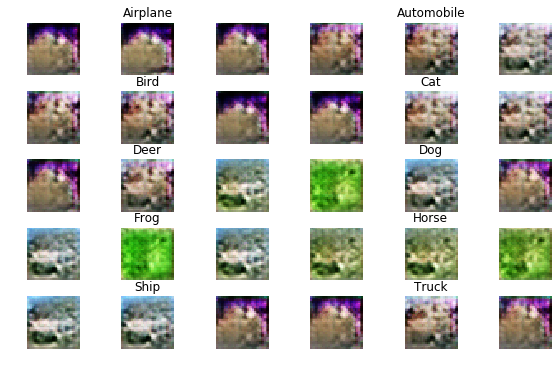

	Epoch: 161, Generator Loss: 0.01190511344909668, Discriminator Loss: [0.00104205 0.        ]


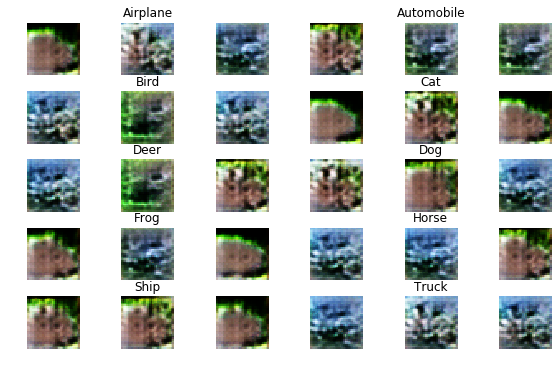

	Epoch: 162, Generator Loss: 0.0111066019821167, Discriminator Loss: [0.00105153 0.        ]


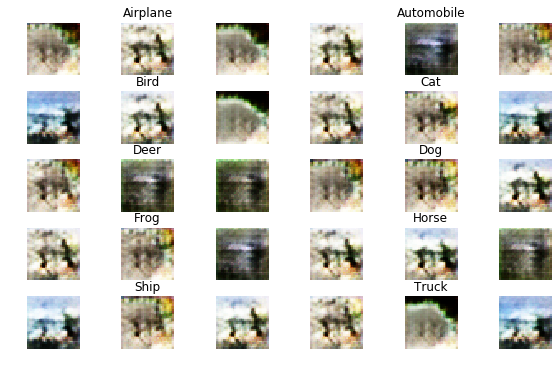

	Epoch: 163, Generator Loss: 0.013633279495239257, Discriminator Loss: [0.00115473 0.        ]


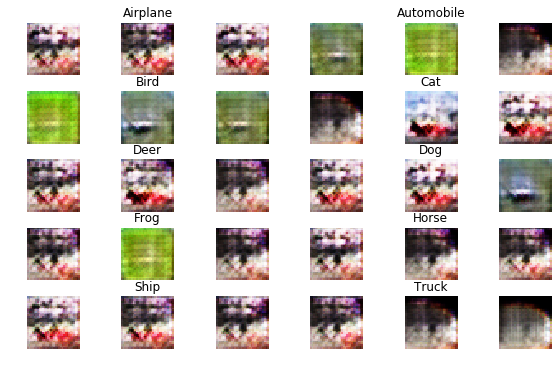

	Epoch: 164, Generator Loss: 0.01204895481109619, Discriminator Loss: [0.00108106 0.        ]


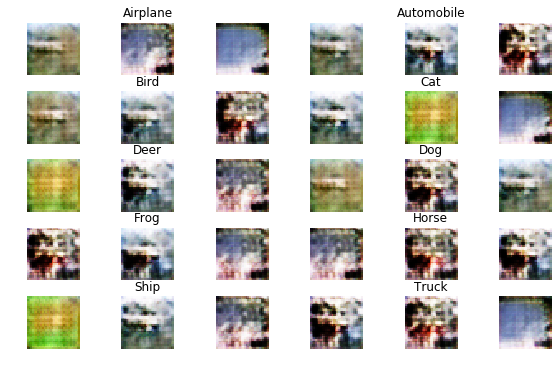

	Epoch: 165, Generator Loss: 0.00925633243560791, Discriminator Loss: [0.00102155 0.        ]


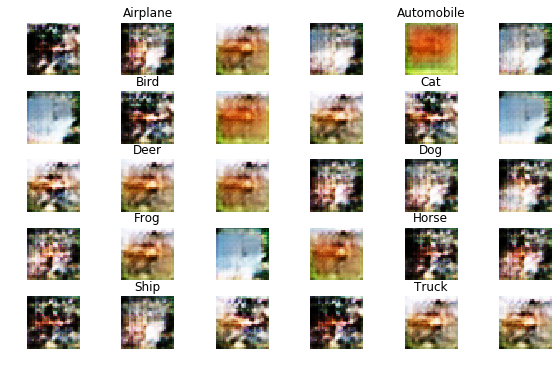

	Epoch: 166, Generator Loss: 0.01406263053894043, Discriminator Loss: [0.00104498 0.        ]


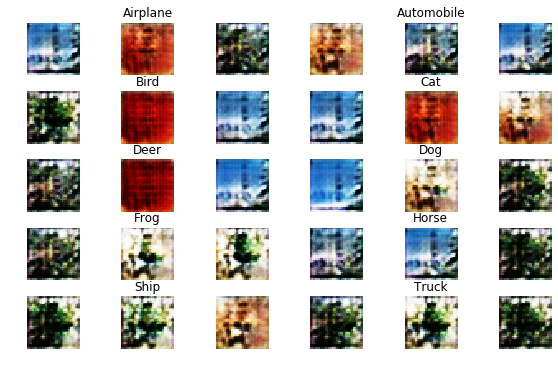

	Epoch: 167, Generator Loss: 0.012914369583129883, Discriminator Loss: [0.00107864 0.        ]


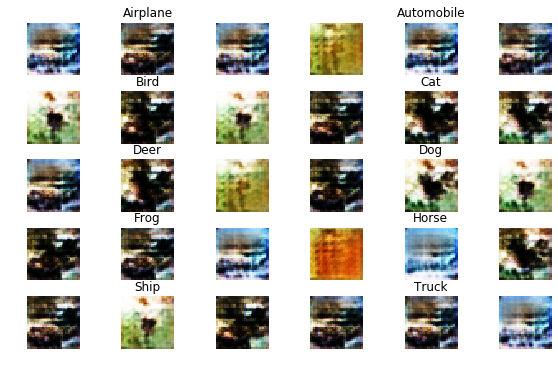

	Epoch: 168, Generator Loss: 0.014199808883666992, Discriminator Loss: [0.00108169 0.        ]


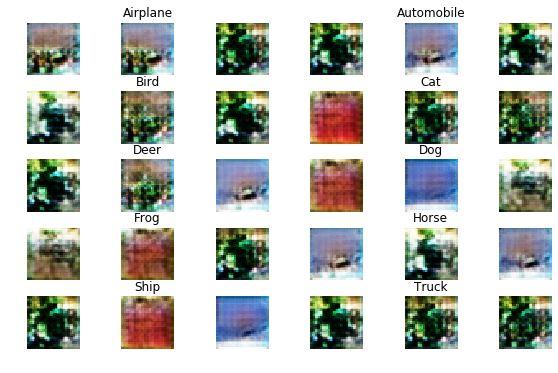

	Epoch: 169, Generator Loss: 0.014262934188842773, Discriminator Loss: [0.00104059 0.        ]


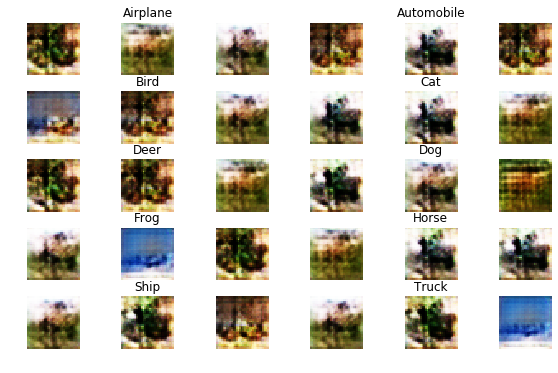

	Epoch: 170, Generator Loss: 0.01543705780029297, Discriminator Loss: [0.00118042 0.        ]


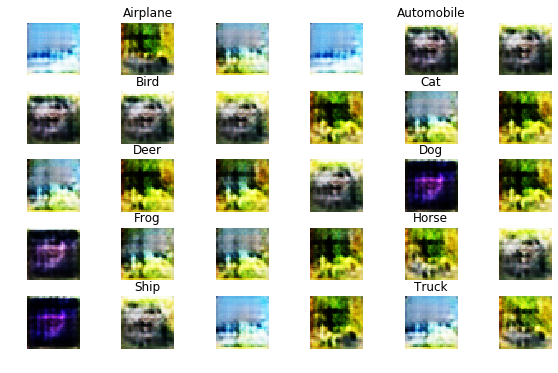

	Epoch: 171, Generator Loss: 0.013877592468261719, Discriminator Loss: [0.00108562 0.        ]


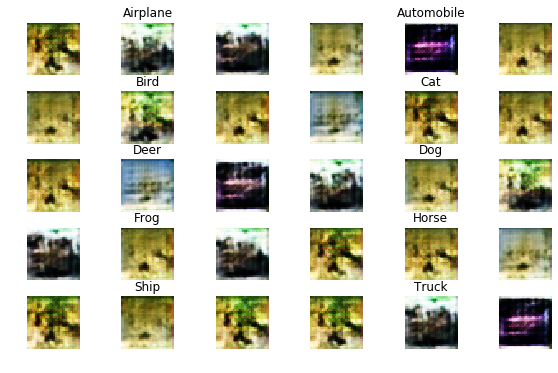

	Epoch: 172, Generator Loss: 0.01379602149963379, Discriminator Loss: [0.00105598 0.        ]


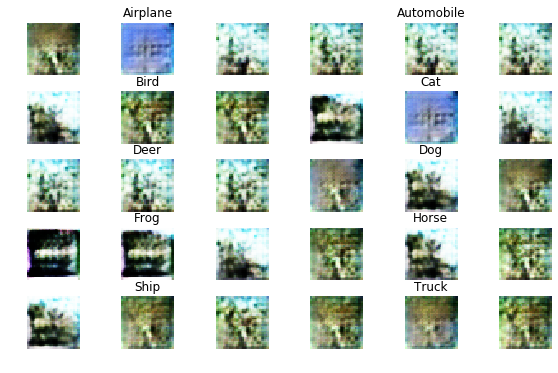

	Epoch: 173, Generator Loss: 0.012879569625854492, Discriminator Loss: [0.00104618 0.        ]


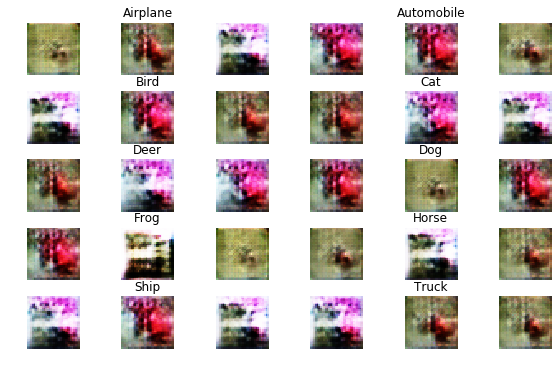

	Epoch: 174, Generator Loss: 0.015420272674560547, Discriminator Loss: [0.00112986 0.        ]


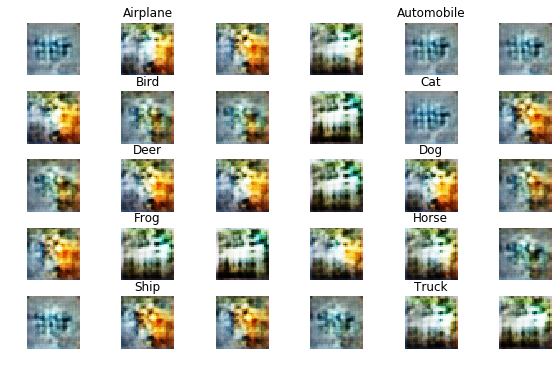

	Epoch: 175, Generator Loss: 0.013314724388122558, Discriminator Loss: [0.00107612 0.        ]


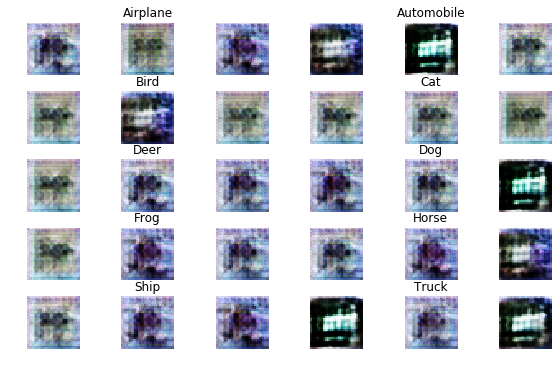

	Epoch: 176, Generator Loss: 0.013278238983154297, Discriminator Loss: [0.00105922 0.        ]


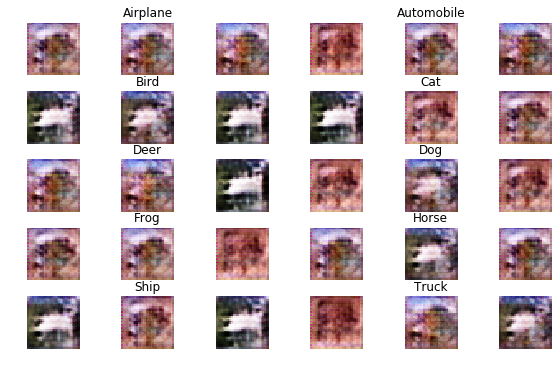

	Epoch: 177, Generator Loss: 0.01387455810546875, Discriminator Loss: [0.00104873 0.        ]


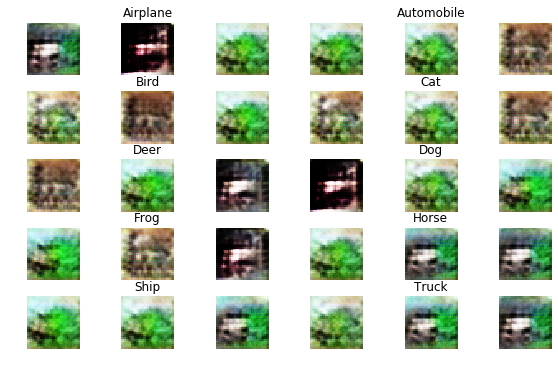

	Epoch: 178, Generator Loss: 0.01433195785522461, Discriminator Loss: [0.00103092 0.        ]


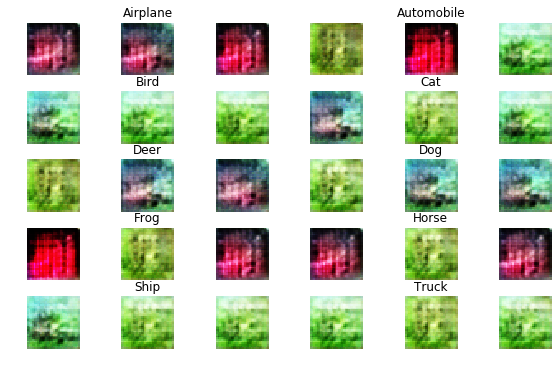

	Epoch: 179, Generator Loss: 0.014221599578857422, Discriminator Loss: [0.00104651 0.        ]


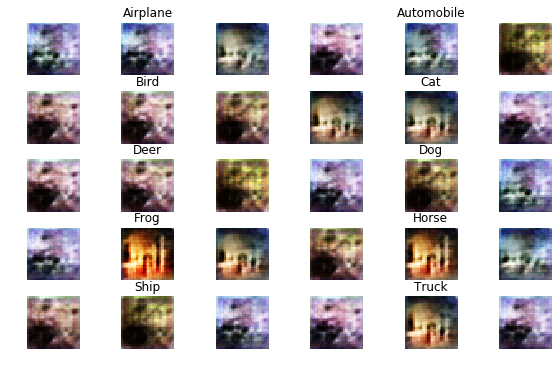

	Epoch: 180, Generator Loss: 0.014372135162353515, Discriminator Loss: [0.00106702 0.        ]


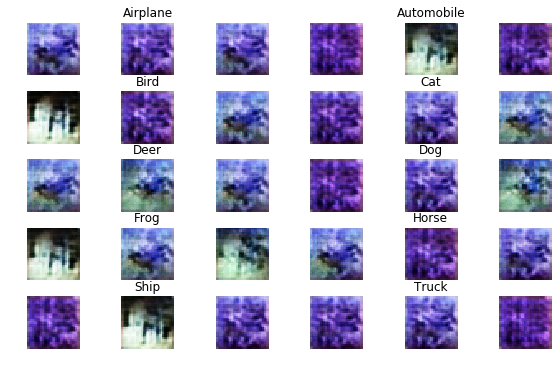

	Epoch: 181, Generator Loss: 0.013588414077758789, Discriminator Loss: [0.00108169 0.        ]


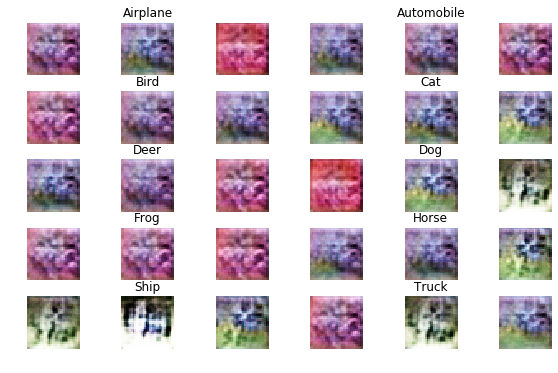

	Epoch: 182, Generator Loss: 0.013642207794189454, Discriminator Loss: [0.00104548 0.        ]


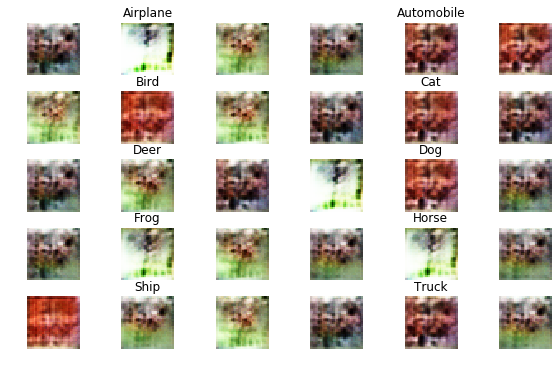

	Epoch: 183, Generator Loss: 0.012511551704406739, Discriminator Loss: [0.00107244 0.        ]


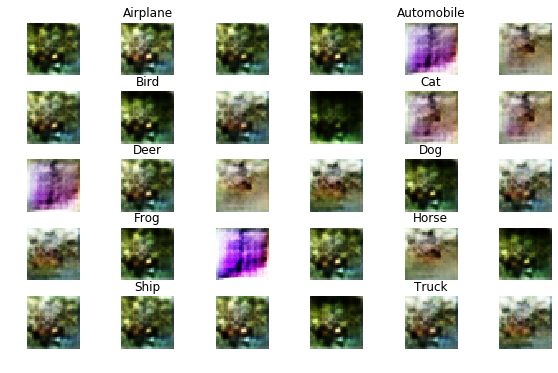

	Epoch: 184, Generator Loss: 0.013148275146484374, Discriminator Loss: [0.00103926 0.        ]


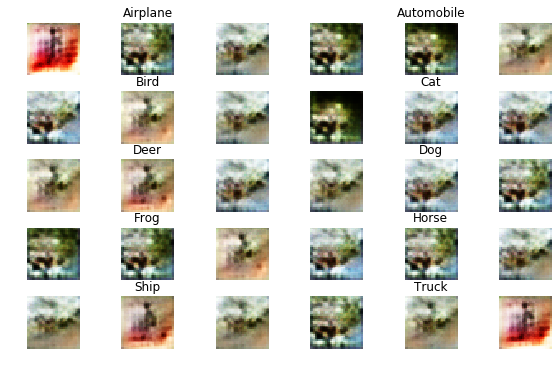

	Epoch: 185, Generator Loss: 0.013150876617431641, Discriminator Loss: [0.00102282 0.        ]


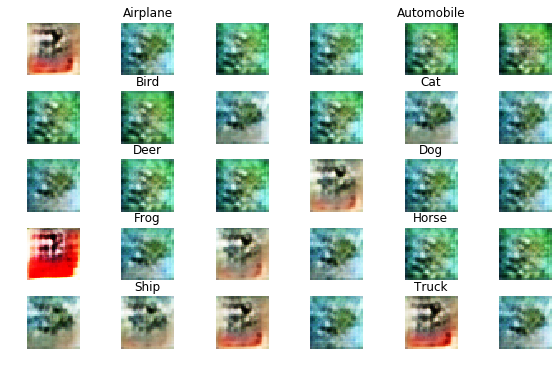

	Epoch: 186, Generator Loss: 0.013857058486938476, Discriminator Loss: [0.00100878 0.        ]


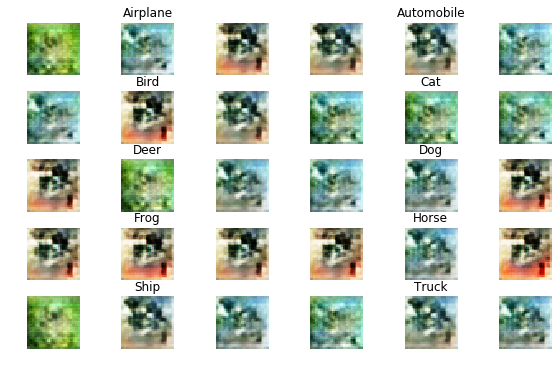

	Epoch: 187, Generator Loss: 0.013796625442504883, Discriminator Loss: [0.00108293 0.        ]


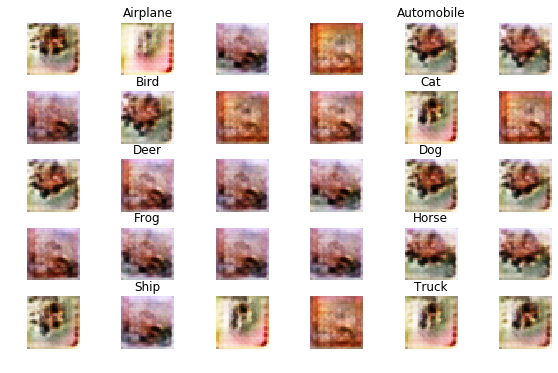

	Epoch: 188, Generator Loss: 0.013852991638183593, Discriminator Loss: [0.00114906 0.        ]


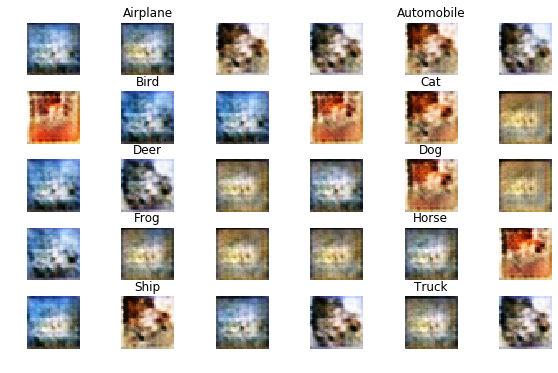

	Epoch: 189, Generator Loss: 0.01346784927368164, Discriminator Loss: [0.00110076 0.        ]


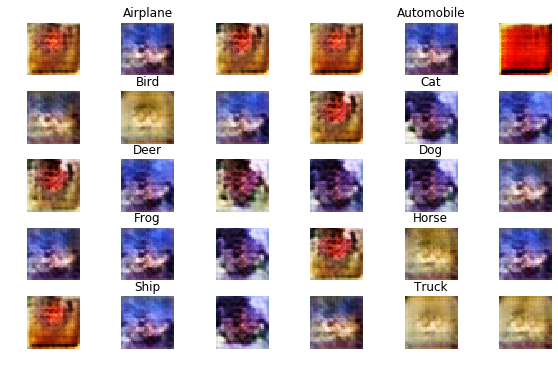

	Epoch: 190, Generator Loss: 0.012140507774353028, Discriminator Loss: [0.00104904 0.        ]


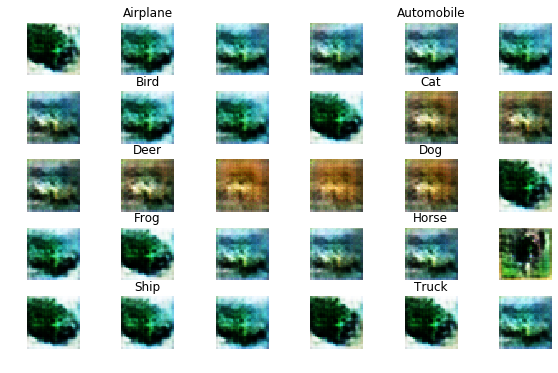

	Epoch: 191, Generator Loss: 0.0122279829788208, Discriminator Loss: [0.00105628 0.        ]


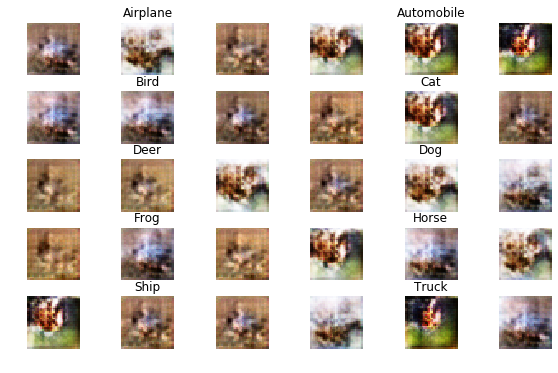

	Epoch: 192, Generator Loss: 0.013579190788269043, Discriminator Loss: [0.00102568 0.        ]


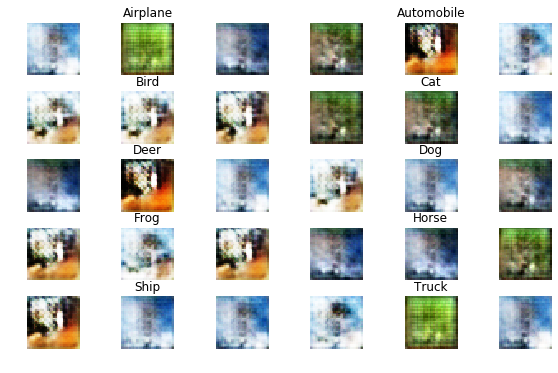

	Epoch: 193, Generator Loss: 0.013845037803649903, Discriminator Loss: [0.00112136 0.        ]


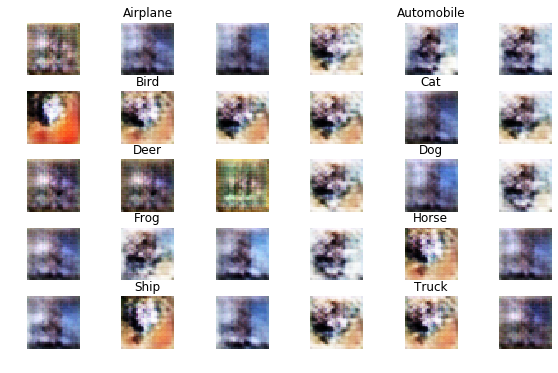

	Epoch: 194, Generator Loss: 0.013830434226989746, Discriminator Loss: [0.0011217 0.       ]


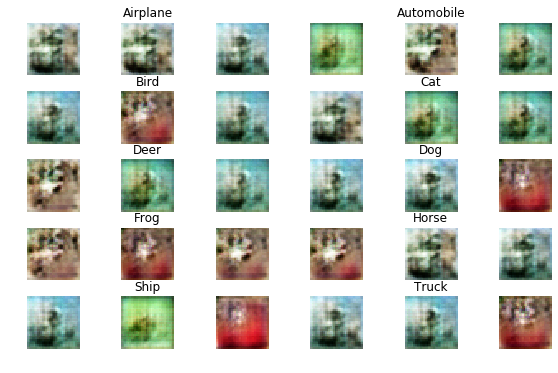

	Epoch: 195, Generator Loss: 0.014186849899291993, Discriminator Loss: [0.00103706 0.        ]


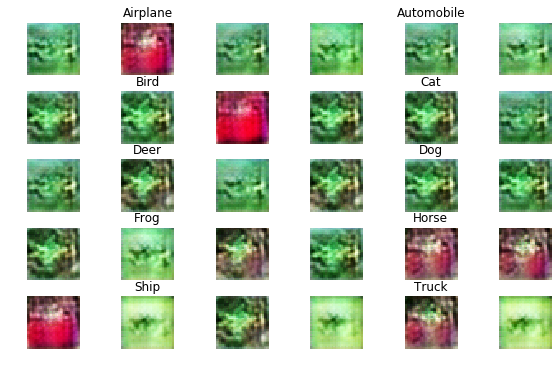

	Epoch: 196, Generator Loss: 0.013833653793334962, Discriminator Loss: [0.00105773 0.        ]


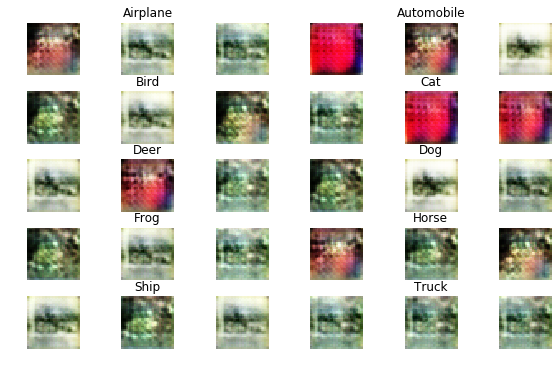

	Epoch: 197, Generator Loss: 0.013162148895263672, Discriminator Loss: [0.00103179 0.        ]


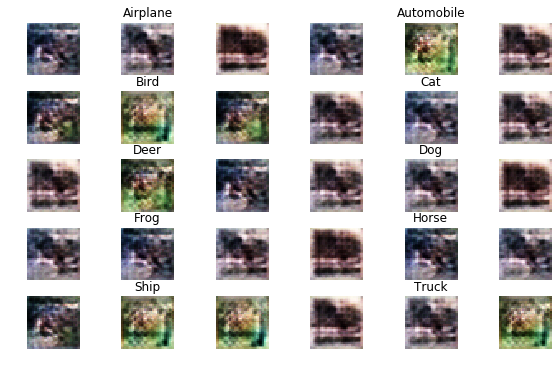

	Epoch: 198, Generator Loss: 0.012742593994140626, Discriminator Loss: [0.00105906 0.        ]


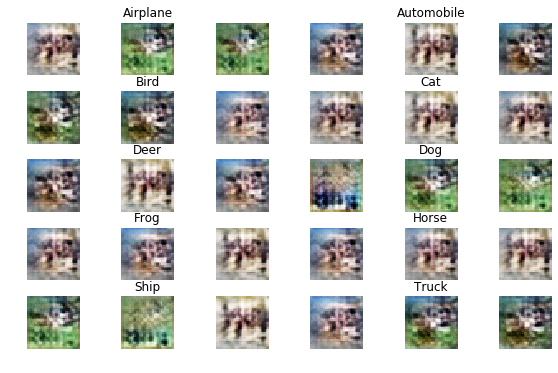

	Epoch: 199, Generator Loss: 0.013132886505126952, Discriminator Loss: [0.00100382 0.        ]


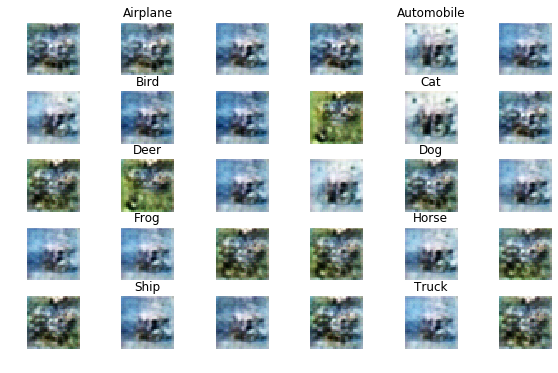

	Epoch: 200, Generator Loss: 0.014849950103759765, Discriminator Loss: [0.00111049 0.        ]


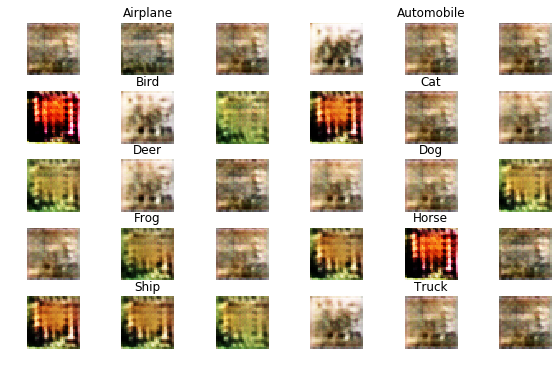

In [8]:
N_EPOCHS = 200
for epoch in range(N_EPOCHS):

    cum_d_loss = 0.
    cum_g_loss = 0.

    for batch_idx in range(num_batches):
    # Get the next set of real images to be used in this iteration
        images = X_train[batch_idx*BATCH_SIZE : (batch_idx+1)*BATCH_SIZE]
        labels = y_train[batch_idx*BATCH_SIZE : (batch_idx+1)*BATCH_SIZE]

        noise_data = generate_noise(BATCH_SIZE, 100)
        random_labels = generate_random_labels(BATCH_SIZE)
        # We use same labels for generated images as in the real training batch
        generated_images = generator.predict([noise_data, labels])

        # Train on soft targets (add noise to targets as well)
        noise_prop = 0.05 # Randomly flip 5% of targets

        # Prepare labels for real data
        true_labels = np.zeros((BATCH_SIZE, 1)) + np.random.uniform(low=0.0, high=0.1, size=(BATCH_SIZE, 1))
        flipped_idx = np.random.choice(np.arange(len(true_labels)), size=int(noise_prop*len(true_labels)))
        true_labels[flipped_idx] = 1 - true_labels[flipped_idx]

        # Train discriminator on real data
        d_loss_true = discriminator.train_on_batch([images, labels], true_labels)

        # Prepare labels for generated data
        gene_labels = np.ones((BATCH_SIZE, 1)) - np.random.uniform(low=0.0, high=0.1, size=(BATCH_SIZE, 1))
        flipped_idx = np.random.choice(np.arange(len(gene_labels)), size=int(noise_prop*len(gene_labels)))

        gene_labels[flipped_idx] = 1 - gene_labels[flipped_idx]

        # Train discriminator on generated data
        d_loss_gene = discriminator.train_on_batch([generated_images, labels], gene_labels)

        # Store a random point for experience replay
        r_idx = np.random.randint(BATCH_SIZE)
        exp_replay.append([generated_images[r_idx], labels[r_idx], gene_labels[r_idx]])

        #If we have enough points, do experience replay
        if len(exp_replay) == BATCH_SIZE:
            generated_images = np.array([p[0] for p in exp_replay])
            labels = np.array([p[1] for p in exp_replay])
            gene_labels = np.array([p[2] for p in exp_replay])
            expprep_loss_gene = discriminator.train_on_batch([generated_images, labels], gene_labels)
            exp_replay = []
            break

        d_loss = 0.5 * np.add(d_loss_true, d_loss_gene)
        cum_d_loss += d_loss

        # Train generator
        noise_data = generate_noise(BATCH_SIZE, 100)
        random_labels = generate_random_labels(BATCH_SIZE)
        g_loss = gan.train_on_batch([noise_data, random_labels, random_labels], np.zeros((BATCH_SIZE, 1)))
        cum_g_loss += g_loss

    print('\tEpoch: {}, Generator Loss: {}, Discriminator Loss: {}'.format(epoch+1, cum_g_loss/num_batches, cum_d_loss/num_batches))
    show_samples("epoch" + str(epoch))